In [1]:
from __future__ import print_function, division
import torch
import torch
import torch.nn as nn
import torch.optim as optim
import data as dt
import model_4_o as md
import copy
from pytorch_ssim import ssim
from torch.utils.data import DataLoader, ConcatDataset
# e/d + i
# best mode so far

In [2]:
# print gpu
torch.cuda.set_device(1)
currentDevice = torch.cuda.current_device()
print("Current GPU: " + str(currentDevice))
print(str(torch.cuda.device_count()))
print(str(torch.cuda.get_device_capability(currentDevice)))
print(torch.__version__)

Current GPU: 1
8
(6, 1)
1.0.0


In [3]:
USE_GPU = 1
if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda:1')
else:
    device = "cpu"
print(device)

cuda:1


In [4]:
# generate csv file, run only for the first time
import csvgenerator as csvg
# csvg.generate_csv()

In [5]:
csvFilePath = dt.get_csv_path()
print(csvFilePath)
transformed_dataset = dt.HE_SHG_Dataset(csv_file=csvFilePath,
                                               transform=dt.Compose([                                              
                                               dt.Rescale(96),                                     
                                               dt.Normalize(),
                                               dt.ToTensor()
                                           ]))
# TODO: change the normalization parameters

/deepdata/adib/HEtoSHG/cs766/Data/image_files.csv


In [6]:
# batchsize 32->16
dataloader = DataLoader(transformed_dataset, batch_size=1200,
                        shuffle=True, num_workers=0)
print(len(transformed_dataset))

1004324


0 torch.Size([1200, 3, 96, 96]) torch.Size([1200, 96, 96])
1 torch.Size([1200, 3, 96, 96]) torch.Size([1200, 96, 96])
2 torch.Size([1200, 3, 96, 96]) torch.Size([1200, 96, 96])
3 torch.Size([1200, 3, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([1200, 1, 96, 96])


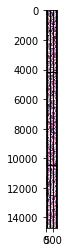

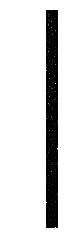

In [7]:
# TODO: insert back mean and variance to plot the image appropriately
dt.show_patch(dataloader) 

In [5]:
import os
cwd = os.getcwd();
path = os.path.join(cwd, 'Saved model', 'encoderresinfo.pth')
model = md.Net()
model.load_state_dict(torch.load(path))
model.eval()


Net(
  (block0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1)
  )
  (block1): Sequential(
    (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.1)
  )
  (info1): Sequential(
    (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.1)
  )
  (block2): Sequential(
    (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  

In [42]:
# criterionMSE = nn.MSELoss()
# criterionMSE = criterionMSE.cuda()
# optimizer = optim.Adam(model.parameters(), lr=0.001)
criterionL = nn.L1Loss()
criterionL = criterionL.cuda()

In [43]:
def train(epoch, p, windowsize):
    epoch_loss = 0
    for iteration, batch in enumerate(dataloader):
        input, target = batch['input'].to(device), batch['output'].to(device)

        optimizer.zero_grad()
        output = model(input)
        targetf = target.float()
        targetf = targetf[:, None]
        
        lossMSE = criterionL(output, targetf)      
        lossSSIM = 1-ssim(output, targetf, window_size=windowsize)
        
        # 0.75->0.4 after 3 epochs
        loss = p*lossMSE + (1-p)*lossSSIM
        combineLoss = p*lossMSE.item() + (1-p)*lossSSIM.item()
        
        epoch_loss = epoch_loss + combineLoss
        loss.backward()
        optimizer.step()
    
        if iteration%50 == 0:
            print("lossL1: " + str(lossMSE.item()) +
                  " " + "lossSSIM: " + str(lossSSIM.item()))
            print("===> Epoch[{}]({}/{}): Loss: {:.4f}".format(epoch, iteration, len(dataloader), loss.item()))

    print("===> Epoch {} Complete: Avg. Loss: {:.4f}".format(epoch, epoch_loss / len(dataloader)))


In [ ]:
# def test():
#     avg_psnr = 0
#     with torch.no_grad():
#         for batch in testing_data_loader:
#             input, target = batch[0].to(device), batch[1].to(device)

#             prediction = model(input)
#             mse = criterion(prediction, target)
#             psnr = 10 * log10(1 / mse.item())
#             avg_psnr += psnr
#     print("===> Avg. PSNR: {:.4f} dB".format(avg_psnr / len(testing_data_loader)))


In [ ]:
# def checkpoint(epoch):
#     model_out_path = "model_epoch_{}.pth".format(epoch)
#     torch.save(model, model_out_path)
#     print("Checkpoint saved to {}".format(model_out_path))

In [ ]:
for epoch in range(1, 10 + 1):
    train(epoch)
#     test()
#     checkpoint(epoch)
#     wanna loss < 0.06

In [20]:
import matplotlib.pyplot as plt
from torchvision import transforms, utils
def test():
    avg_psnr = 0
    with torch.no_grad():
        for iteration, batch in enumerate(dataloader):
            input, target = batch['input'].to(device), batch['output'].to(device)
                
            prediction = model(input)

            target = target.float()

            outdataloader = {'input':prediction,'output':target}
            
            print(outdataloader['input'].size(), 
                      outdataloader['output'].size())

            plt.figure()
            input_batch, label_batch = outdataloader['input'], outdataloader['output']
            
            input = input[0:32, :, :, :]
            input_batch = input_batch[0:32, :, :, :]
            label_batch = label_batch[0:32, :, :]
            
            batch_size = 32
            im_size = input_batch.size(2)
            label_batch=label_batch.reshape([batch_size,1,im_size,im_size])
            print(label_batch.size())
#             for img in input_batch:
#                 for t, m, s in zip(img, [0.5, 0.5, 0.5], [0.5, 0.5, 0.5]):
#                     t.mul_(s).add_(m)
                            
#             for img in label_batch:
#                 for t, m, s in zip(img, [0.5, 0.5, 0.5], [0.5, 0.5, 0.5]):
#                     t.mul_(s).add_(m)                           
            grid = utils.make_grid(input).cpu()
            plt.imshow(grid.numpy().transpose((1, 2, 0)))
            plt.figure()
    
            grid = utils.make_grid(input_batch).cpu()
            plt.imshow(grid.numpy().transpose((1, 2, 0)))
            plt.figure()

            grid = utils.make_grid(label_batch).cpu()
            plt.imshow(grid.numpy().transpose((1, 2, 0)))

            plt.axis('off')
            plt.ioff()
            plt.show()
            
            targetf = target[:, None]
            
            lossMSE = criterionMSE(prediction, targetf)      
            lossSSIM = -ssim(prediction, targetf)
        
            p = 0.25
            loss = p*lossMSE + (1-p)*lossSSIM
            combineLoss = p*lossMSE.item() + (1-p)*lossSSIM.item()
#             mse = criterion(prediction, target.float())

            psnr = 10 * torch.log10(1 / loss)
            avg_psnr += psnr
            if iteration == 16:
                break
    print("===> Avg. PSNR: {:.4f} dB".format(avg_psnr / len(dataloader)))

In [ ]:
test()

In [ ]:
l = 0.0001
p = 0.5
windowsize = 3
for epoch in range(1, 18 + 1):
    if epoch%2 == 0:
        windowsize = windowsize+1
        p = p*0.8
        l = l*0.2
        if windowsize == 0:
            windowsze = 1
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

In [ ]:
test()

In [ ]:
import os
cwd = os.getcwd();
path = os.path.join(cwd, 'Saved model', 'encoderresinfo.pth')
torch.save(model.state_dict(), path)

In [ ]:
l = 0.0001
p = 0
windowsize = 4
for epoch in range(1, 20 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*0.2
        if windowsize == 0:
            windowsze = 1
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

In [ ]:
l = 0.00001
p = 0
windowsize = 10
for epoch in range(1, 20 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*0.2
        if windowsize >= 20:
            windowsze = 20
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

In [ ]:
test()

In [9]:
gpu_ids = [1, 2, 3, 4, 5, 6]
torch.cuda.set_device(gpu_ids[0])
model = torch.nn.DataParallel(model, device_ids=gpu_ids)
model.cuda()

DataParallel(
  (module): Net(
    (block0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.1)
    )
    (block1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.1)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.1)
    )
    (info1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.1)
    )
    (block2): Sequential(
      (0): Co

In [10]:
l = 0.0001
p = 0
windowsize = 10
for epoch in range(1, 20 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 20:
            windowsze = 20
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossMSE: 0.0061826989986002445 lossSSIM: 0.26286572217941284
===> Epoch[1](0/676): Loss: 0.2629
lossMSE: 0.007225800771266222 lossSSIM: 0.26099473237991333
===> Epoch[1](50/676): Loss: 0.2610
lossMSE: 0.006101866252720356 lossSSIM: 0.2660636901855469
===> Epoch[1](100/676): Loss: 0.2661
lossMSE: 0.006052036304026842 lossSSIM: 0.2484944462776184
===> Epoch[1](150/676): Loss: 0.2485
lossMSE: 0.006251385901123285 lossSSIM: 0.2548221945762634
===> Epoch[1](200/676): Loss: 0.2548
lossMSE: 0.007263422477990389 lossSSIM: 0.2613692879676819
===> Epoch[1](250/676): Loss: 0.2614
lossMSE: 0.0062272027134895325 lossSSIM: 0.2564438581466675
===> Epoch[1](300/676): Loss: 0.2564
lossMSE: 0.006103506311774254 lossSSIM: 0.2573243975639343
===> Epoch[1](350/676): Loss: 0.2573
lossMSE: 0.0060762688517570496 lossSSIM: 0.2600712180137634
===> Epoch[1](400/676): Loss: 0.2601
lossMSE: 0.006617461796849966 lossSSIM: 0.2579900026321411
===> Epoch[1](450/676): Loss: 0.2580
lossMSE: 0.00664266524836421 lossSSIM:

===> Epoch 6 Complete: Avg. Loss: 0.2620
lossMSE: 0.0074668582528829575 lossSSIM: 0.2746887803077698
===> Epoch[7](0/676): Loss: 0.2747
lossMSE: 0.006691941060125828 lossSSIM: 0.26588064432144165
===> Epoch[7](50/676): Loss: 0.2659
lossMSE: 0.007539073936641216 lossSSIM: 0.2672088146209717
===> Epoch[7](100/676): Loss: 0.2672
lossMSE: 0.006694955285638571 lossSSIM: 0.2552531957626343
===> Epoch[7](150/676): Loss: 0.2553
lossMSE: 0.007189897820353508 lossSSIM: 0.26018548011779785
===> Epoch[7](200/676): Loss: 0.2602
lossMSE: 0.006568498443812132 lossSSIM: 0.2538940906524658
===> Epoch[7](250/676): Loss: 0.2539
lossMSE: 0.007261935155838728 lossSSIM: 0.26421958208084106
===> Epoch[7](300/676): Loss: 0.2642
lossMSE: 0.006038019433617592 lossSSIM: 0.2586071491241455
===> Epoch[7](350/676): Loss: 0.2586
lossMSE: 0.007561223115772009 lossSSIM: 0.27107447385787964
===> Epoch[7](400/676): Loss: 0.2711
lossMSE: 0.005891743581742048 lossSSIM: 0.2527363896369934
===> Epoch[7](450/676): Loss: 0.25

lossMSE: 0.006793653592467308 lossSSIM: 0.2604805827140808
===> Epoch[12](650/676): Loss: 0.2605
===> Epoch 12 Complete: Avg. Loss: 0.2619
lossMSE: 0.007115494925528765 lossSSIM: 0.2633376121520996
===> Epoch[13](0/676): Loss: 0.2633
lossMSE: 0.006557554937899113 lossSSIM: 0.260015070438385
===> Epoch[13](50/676): Loss: 0.2600
lossMSE: 0.006561868358403444 lossSSIM: 0.25471264123916626
===> Epoch[13](100/676): Loss: 0.2547
lossMSE: 0.007131645921617746 lossSSIM: 0.27166199684143066
===> Epoch[13](150/676): Loss: 0.2717
lossMSE: 0.007268934510648251 lossSSIM: 0.26648807525634766
===> Epoch[13](200/676): Loss: 0.2665
lossMSE: 0.0054704053327441216 lossSSIM: 0.2532948851585388
===> Epoch[13](250/676): Loss: 0.2533
lossMSE: 0.0072773052379488945 lossSSIM: 0.26844966411590576
===> Epoch[13](300/676): Loss: 0.2684
lossMSE: 0.006924827117472887 lossSSIM: 0.27977538108825684
===> Epoch[13](350/676): Loss: 0.2798
lossMSE: 0.006973852403461933 lossSSIM: 0.25744229555130005
===> Epoch[13](400/676

lossMSE: 0.006061266642063856 lossSSIM: 0.2543175220489502
===> Epoch[18](550/676): Loss: 0.2543
lossMSE: 0.006949311122298241 lossSSIM: 0.2588895559310913
===> Epoch[18](600/676): Loss: 0.2589
lossMSE: 0.007043274585157633 lossSSIM: 0.2649775743484497
===> Epoch[18](650/676): Loss: 0.2650
===> Epoch 18 Complete: Avg. Loss: 0.2618
lossMSE: 0.0068953437730669975 lossSSIM: 0.2668514847755432
===> Epoch[19](0/676): Loss: 0.2669
lossMSE: 0.006092885509133339 lossSSIM: 0.25203579664230347
===> Epoch[19](50/676): Loss: 0.2520
lossMSE: 0.005996382795274258 lossSSIM: 0.2530503273010254
===> Epoch[19](100/676): Loss: 0.2531
lossMSE: 0.007369290105998516 lossSSIM: 0.27218031883239746
===> Epoch[19](150/676): Loss: 0.2722
lossMSE: 0.006428185384720564 lossSSIM: 0.258600652217865
===> Epoch[19](200/676): Loss: 0.2586
lossMSE: 0.006828335579484701 lossSSIM: 0.25857383012771606
===> Epoch[19](250/676): Loss: 0.2586
lossMSE: 0.006508093327283859 lossSSIM: 0.2555738091468811
===> Epoch[19](300/676): L

In [11]:
l = 0.001
p = 0
windowsize = 10
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 20:
            windowsze = 20
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossMSE: 0.00649360241368413 lossSSIM: 0.2575039267539978
===> Epoch[1](0/676): Loss: 0.2575
lossMSE: 0.006390407215803862 lossSSIM: 0.25440138578414917
===> Epoch[1](50/676): Loss: 0.2544
lossMSE: 0.006614970974624157 lossSSIM: 0.26824480295181274
===> Epoch[1](100/676): Loss: 0.2682
lossMSE: 0.0075506893917918205 lossSSIM: 0.26137441396713257
===> Epoch[1](150/676): Loss: 0.2614
lossMSE: 0.006369191687554121 lossSSIM: 0.2585170865058899
===> Epoch[1](200/676): Loss: 0.2585
lossMSE: 0.00619878014549613 lossSSIM: 0.263511061668396
===> Epoch[1](250/676): Loss: 0.2635
lossMSE: 0.007016080431640148 lossSSIM: 0.2656596302986145
===> Epoch[1](300/676): Loss: 0.2657
lossMSE: 0.006515444256365299 lossSSIM: 0.2633575201034546
===> Epoch[1](350/676): Loss: 0.2634
lossMSE: 0.006589691620320082 lossSSIM: 0.2657267451286316
===> Epoch[1](400/676): Loss: 0.2657
lossMSE: 0.0072065615095198154 lossSSIM: 0.27124303579330444
===> Epoch[1](450/676): Loss: 0.2712
lossMSE: 0.006651228293776512 lossSSIM: 

===> Epoch 6 Complete: Avg. Loss: 0.2619
lossMSE: 0.006690953392535448 lossSSIM: 0.2620896100997925
===> Epoch[7](0/676): Loss: 0.2621
lossMSE: 0.007495889440178871 lossSSIM: 0.2672097682952881
===> Epoch[7](50/676): Loss: 0.2672
lossMSE: 0.007589578162878752 lossSSIM: 0.2699030637741089
===> Epoch[7](100/676): Loss: 0.2699
lossMSE: 0.005833015777170658 lossSSIM: 0.25563716888427734
===> Epoch[7](150/676): Loss: 0.2556
lossMSE: 0.006275692488998175 lossSSIM: 0.25534820556640625
===> Epoch[7](200/676): Loss: 0.2553
lossMSE: 0.005674084648489952 lossSSIM: 0.2575336694717407
===> Epoch[7](250/676): Loss: 0.2575
lossMSE: 0.0062295920215547085 lossSSIM: 0.25275105237960815
===> Epoch[7](300/676): Loss: 0.2528
lossMSE: 0.006321091670542955 lossSSIM: 0.25983482599258423
===> Epoch[7](350/676): Loss: 0.2598
lossMSE: 0.0061146412044763565 lossSSIM: 0.25911223888397217
===> Epoch[7](400/676): Loss: 0.2591
lossMSE: 0.006117822136729956 lossSSIM: 0.2617321014404297
===> Epoch[7](450/676): Loss: 0.

lossMSE: 0.006208880338817835 lossSSIM: 0.2597799301147461
===> Epoch[12](650/676): Loss: 0.2598
===> Epoch 12 Complete: Avg. Loss: 0.2613
lossMSE: 0.005852189380675554 lossSSIM: 0.2516065835952759
===> Epoch[13](0/676): Loss: 0.2516
lossMSE: 0.006552168633788824 lossSSIM: 0.26587730646133423
===> Epoch[13](50/676): Loss: 0.2659
lossMSE: 0.005699592642486095 lossSSIM: 0.2589109539985657
===> Epoch[13](100/676): Loss: 0.2589
lossMSE: 0.006968987174332142 lossSSIM: 0.2698909640312195
===> Epoch[13](150/676): Loss: 0.2699
lossMSE: 0.006052883807569742 lossSSIM: 0.25588148832321167
===> Epoch[13](200/676): Loss: 0.2559
lossMSE: 0.006225705146789551 lossSSIM: 0.26591062545776367
===> Epoch[13](250/676): Loss: 0.2659
lossMSE: 0.00680080009624362 lossSSIM: 0.2636934518814087
===> Epoch[13](300/676): Loss: 0.2637
lossMSE: 0.006636560428887606 lossSSIM: 0.25999557971954346
===> Epoch[13](350/676): Loss: 0.2600
lossMSE: 0.007141582202166319 lossSSIM: 0.2592223882675171
===> Epoch[13](400/676): L

KeyboardInterrupt: 

In [13]:
l = 0.005
p = 0
windowsize = 12
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 16:
            windowsze = 16
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossMSE: 0.007893196307122707 lossSSIM: 0.29469984769821167
===> Epoch[1](0/676): Loss: 0.2947
lossMSE: 0.007182117085903883 lossSSIM: 0.28323882818222046
===> Epoch[1](50/676): Loss: 0.2832
lossMSE: 0.006793836131691933 lossSSIM: 0.2764155864715576
===> Epoch[1](100/676): Loss: 0.2764
lossMSE: 0.007442289497703314 lossSSIM: 0.274247944355011
===> Epoch[1](150/676): Loss: 0.2742
lossMSE: 0.0061234417371451855 lossSSIM: 0.2635205388069153
===> Epoch[1](200/676): Loss: 0.2635
lossMSE: 0.007460900116711855 lossSSIM: 0.27335256338119507
===> Epoch[1](250/676): Loss: 0.2734
lossMSE: 0.0064965044148266315 lossSSIM: 0.26037561893463135
===> Epoch[1](300/676): Loss: 0.2604
lossMSE: 0.006868039723485708 lossSSIM: 0.2577994465827942
===> Epoch[1](350/676): Loss: 0.2578
lossMSE: 0.007156586740165949 lossSSIM: 0.2581159472465515
===> Epoch[1](400/676): Loss: 0.2581
lossMSE: 0.00600135512650013 lossSSIM: 0.25809985399246216
===> Epoch[1](450/676): Loss: 0.2581
lossMSE: 0.006207327824085951 lossSSIM

===> Epoch 6 Complete: Avg. Loss: 0.2642
lossMSE: 0.007071048021316528 lossSSIM: 0.26256710290908813
===> Epoch[7](0/676): Loss: 0.2626
lossMSE: 0.007511557079851627 lossSSIM: 0.26521849632263184
===> Epoch[7](50/676): Loss: 0.2652
lossMSE: 0.006430226843804121 lossSSIM: 0.2657700777053833
===> Epoch[7](100/676): Loss: 0.2658
lossMSE: 0.007603860925883055 lossSSIM: 0.2647833824157715
===> Epoch[7](150/676): Loss: 0.2648
lossMSE: 0.006077810190618038 lossSSIM: 0.2599230408668518
===> Epoch[7](200/676): Loss: 0.2599
lossMSE: 0.006454692222177982 lossSSIM: 0.26665204763412476
===> Epoch[7](250/676): Loss: 0.2667
lossMSE: 0.006814422085881233 lossSSIM: 0.25952303409576416
===> Epoch[7](300/676): Loss: 0.2595
lossMSE: 0.00816029030829668 lossSSIM: 0.2607625722885132
===> Epoch[7](350/676): Loss: 0.2608
lossMSE: 0.005881082266569138 lossSSIM: 0.25140881538391113
===> Epoch[7](400/676): Loss: 0.2514
lossMSE: 0.007026921957731247 lossSSIM: 0.261482298374176
===> Epoch[7](450/676): Loss: 0.2615

lossMSE: 0.00574009632691741 lossSSIM: 0.2526765465736389
===> Epoch[12](650/676): Loss: 0.2527
===> Epoch 12 Complete: Avg. Loss: 0.2622
lossMSE: 0.0078229159116745 lossSSIM: 0.2722821831703186
===> Epoch[13](0/676): Loss: 0.2723
lossMSE: 0.005926814395934343 lossSSIM: 0.25871825218200684
===> Epoch[13](50/676): Loss: 0.2587
lossMSE: 0.0073097944259643555 lossSSIM: 0.26126646995544434
===> Epoch[13](100/676): Loss: 0.2613
lossMSE: 0.006155519280582666 lossSSIM: 0.2589484453201294
===> Epoch[13](150/676): Loss: 0.2589
lossMSE: 0.006598445121198893 lossSSIM: 0.24903541803359985
===> Epoch[13](200/676): Loss: 0.2490
lossMSE: 0.006070698611438274 lossSSIM: 0.2588949203491211
===> Epoch[13](250/676): Loss: 0.2589
lossMSE: 0.006272806320339441 lossSSIM: 0.26031529903411865
===> Epoch[13](300/676): Loss: 0.2603
lossMSE: 0.006402990780770779 lossSSIM: 0.2557840943336487
===> Epoch[13](350/676): Loss: 0.2558
lossMSE: 0.006352097727358341 lossSSIM: 0.25905120372772217
===> Epoch[13](400/676): L

lossMSE: 0.0059328568167984486 lossSSIM: 0.26005852222442627
===> Epoch[18](550/676): Loss: 0.2601
lossMSE: 0.005903433542698622 lossSSIM: 0.2587625980377197
===> Epoch[18](600/676): Loss: 0.2588
lossMSE: 0.006827028002589941 lossSSIM: 0.25861090421676636
===> Epoch[18](650/676): Loss: 0.2586
===> Epoch 18 Complete: Avg. Loss: 0.2612
lossMSE: 0.00561586394906044 lossSSIM: 0.25061047077178955
===> Epoch[19](0/676): Loss: 0.2506
lossMSE: 0.006264632102102041 lossSSIM: 0.25821638107299805
===> Epoch[19](50/676): Loss: 0.2582
lossMSE: 0.006539321504533291 lossSSIM: 0.2606229782104492
===> Epoch[19](100/676): Loss: 0.2606
lossMSE: 0.00649147666990757 lossSSIM: 0.2559915781021118
===> Epoch[19](150/676): Loss: 0.2560
lossMSE: 0.006951265037059784 lossSSIM: 0.26227062940597534
===> Epoch[19](200/676): Loss: 0.2623
lossMSE: 0.005861871410161257 lossSSIM: 0.2605118155479431
===> Epoch[19](250/676): Loss: 0.2605
lossMSE: 0.0063163102604448795 lossSSIM: 0.26511311531066895
===> Epoch[19](300/676)

lossMSE: 0.0058670747093856335 lossSSIM: 0.2600933313369751
===> Epoch[24](450/676): Loss: 0.2601
lossMSE: 0.007442327216267586 lossSSIM: 0.2667045593261719
===> Epoch[24](500/676): Loss: 0.2667
lossMSE: 0.00633067823946476 lossSSIM: 0.2664073705673218
===> Epoch[24](550/676): Loss: 0.2664
lossMSE: 0.005778285674750805 lossSSIM: 0.2530285120010376
===> Epoch[24](600/676): Loss: 0.2530
lossMSE: 0.006617178674787283 lossSSIM: 0.262759804725647
===> Epoch[24](650/676): Loss: 0.2628
===> Epoch 24 Complete: Avg. Loss: 0.2602
lossMSE: 0.0066306437365710735 lossSSIM: 0.2643713355064392
===> Epoch[25](0/676): Loss: 0.2644
lossMSE: 0.00772565184161067 lossSSIM: 0.26634275913238525
===> Epoch[25](50/676): Loss: 0.2663
lossMSE: 0.007714930456131697 lossSSIM: 0.2720068693161011
===> Epoch[25](100/676): Loss: 0.2720
lossMSE: 0.006580830551683903 lossSSIM: 0.26124072074890137
===> Epoch[25](150/676): Loss: 0.2612
lossMSE: 0.006662558298557997 lossSSIM: 0.2564198970794678
===> Epoch[25](200/676): Los

lossMSE: 0.006031375378370285 lossSSIM: 0.2546645998954773
===> Epoch[30](350/676): Loss: 0.2547
lossMSE: 0.0066394987516105175 lossSSIM: 0.2645717263221741
===> Epoch[30](400/676): Loss: 0.2646
lossMSE: 0.006735504139214754 lossSSIM: 0.26207417249679565
===> Epoch[30](450/676): Loss: 0.2621
lossMSE: 0.006727263331413269 lossSSIM: 0.2604501247406006
===> Epoch[30](500/676): Loss: 0.2605
lossMSE: 0.006743548437952995 lossSSIM: 0.26539891958236694
===> Epoch[30](550/676): Loss: 0.2654
lossMSE: 0.0067847613245248795 lossSSIM: 0.2537690997123718
===> Epoch[30](600/676): Loss: 0.2538
lossMSE: 0.006598772946745157 lossSSIM: 0.26047056913375854
===> Epoch[30](650/676): Loss: 0.2605
===> Epoch 30 Complete: Avg. Loss: 0.2595
lossMSE: 0.006854885257780552 lossSSIM: 0.2559024691581726
===> Epoch[31](0/676): Loss: 0.2559
lossMSE: 0.006586022675037384 lossSSIM: 0.2610166072845459
===> Epoch[31](50/676): Loss: 0.2610
lossMSE: 0.0061453175731003284 lossSSIM: 0.2552858591079712
===> Epoch[31](100/676)

lossMSE: 0.006700205150991678 lossSSIM: 0.2515655755996704
===> Epoch[36](250/676): Loss: 0.2516
lossMSE: 0.007263279519975185 lossSSIM: 0.27135610580444336
===> Epoch[36](300/676): Loss: 0.2714
lossMSE: 0.005835692398250103 lossSSIM: 0.2574785351753235
===> Epoch[36](350/676): Loss: 0.2575
lossMSE: 0.005968864541500807 lossSSIM: 0.25927025079727173
===> Epoch[36](400/676): Loss: 0.2593
lossMSE: 0.0070869699120521545 lossSSIM: 0.26308000087738037
===> Epoch[36](450/676): Loss: 0.2631
lossMSE: 0.006478248164057732 lossSSIM: 0.24891281127929688
===> Epoch[36](500/676): Loss: 0.2489
lossMSE: 0.006854371167719364 lossSSIM: 0.26782578229904175
===> Epoch[36](550/676): Loss: 0.2678
lossMSE: 0.005919025745242834 lossSSIM: 0.2579084038734436
===> Epoch[36](600/676): Loss: 0.2579
lossMSE: 0.006245963275432587 lossSSIM: 0.2522704005241394
===> Epoch[36](650/676): Loss: 0.2523
===> Epoch 36 Complete: Avg. Loss: 0.2587
lossMSE: 0.005963420029729605 lossSSIM: 0.2516472339630127
===> Epoch[37](0/676

lossMSE: 0.007139502093195915 lossSSIM: 0.2611304521560669
===> Epoch[42](150/676): Loss: 0.2611
lossMSE: 0.006186941638588905 lossSSIM: 0.25355637073516846
===> Epoch[42](200/676): Loss: 0.2536
lossMSE: 0.006688892841339111 lossSSIM: 0.2553371787071228
===> Epoch[42](250/676): Loss: 0.2553
lossMSE: 0.0066738128662109375 lossSSIM: 0.2601734399795532
===> Epoch[42](300/676): Loss: 0.2602
lossMSE: 0.007694477681070566 lossSSIM: 0.2587733864784241
===> Epoch[42](350/676): Loss: 0.2588
lossMSE: 0.00662180595099926 lossSSIM: 0.2601926922798157
===> Epoch[42](400/676): Loss: 0.2602
lossMSE: 0.006901542656123638 lossSSIM: 0.26124072074890137
===> Epoch[42](450/676): Loss: 0.2612
lossMSE: 0.006978724617511034 lossSSIM: 0.27054065465927124
===> Epoch[42](500/676): Loss: 0.2705
lossMSE: 0.006267043296247721 lossSSIM: 0.2596970796585083
===> Epoch[42](550/676): Loss: 0.2597
lossMSE: 0.00696337828412652 lossSSIM: 0.2624695897102356
===> Epoch[42](600/676): Loss: 0.2625
lossMSE: 0.00586071424186229

lossMSE: 0.0058972518891096115 lossSSIM: 0.24542373418807983
===> Epoch[48](50/676): Loss: 0.2454
lossMSE: 0.007467313669621944 lossSSIM: 0.2555348873138428
===> Epoch[48](100/676): Loss: 0.2555
lossMSE: 0.006843665614724159 lossSSIM: 0.25539201498031616
===> Epoch[48](150/676): Loss: 0.2554
lossMSE: 0.0056467680260539055 lossSSIM: 0.2529791593551636
===> Epoch[48](200/676): Loss: 0.2530
lossMSE: 0.00718065956607461 lossSSIM: 0.25888317823410034
===> Epoch[48](250/676): Loss: 0.2589
lossMSE: 0.006141566671431065 lossSSIM: 0.2567158341407776
===> Epoch[48](300/676): Loss: 0.2567
lossMSE: 0.006798442453145981 lossSSIM: 0.2612783908843994
===> Epoch[48](350/676): Loss: 0.2613
lossMSE: 0.006486222147941589 lossSSIM: 0.26262885332107544
===> Epoch[48](400/676): Loss: 0.2626
lossMSE: 0.006213740445673466 lossSSIM: 0.2640829086303711
===> Epoch[48](450/676): Loss: 0.2641
lossMSE: 0.0054718987084925175 lossSSIM: 0.250494122505188
===> Epoch[48](500/676): Loss: 0.2505
lossMSE: 0.006214591674506

===> Epoch 53 Complete: Avg. Loss: 0.2569
lossMSE: 0.006972497329115868 lossSSIM: 0.26230698823928833
===> Epoch[54](0/676): Loss: 0.2623
lossMSE: 0.006109630223363638 lossSSIM: 0.2519570589065552
===> Epoch[54](50/676): Loss: 0.2520
lossMSE: 0.007256031967699528 lossSSIM: 0.26561498641967773
===> Epoch[54](100/676): Loss: 0.2656
lossMSE: 0.006248360499739647 lossSSIM: 0.2635355591773987
===> Epoch[54](150/676): Loss: 0.2635
lossMSE: 0.00614717835560441 lossSSIM: 0.2534297704696655
===> Epoch[54](200/676): Loss: 0.2534
lossMSE: 0.005532396491616964 lossSSIM: 0.24611026048660278
===> Epoch[54](250/676): Loss: 0.2461
lossMSE: 0.00640105502679944 lossSSIM: 0.25691187381744385
===> Epoch[54](300/676): Loss: 0.2569
lossMSE: 0.005281345918774605 lossSSIM: 0.24262654781341553
===> Epoch[54](350/676): Loss: 0.2426
lossMSE: 0.006022998597472906 lossSSIM: 0.25147396326065063
===> Epoch[54](400/676): Loss: 0.2515
lossMSE: 0.006151385605335236 lossSSIM: 0.25601351261138916
===> Epoch[54](450/676):

lossMSE: 0.006256143096834421 lossSSIM: 0.2520052194595337
===> Epoch[59](600/676): Loss: 0.2520
lossMSE: 0.006264589261263609 lossSSIM: 0.2583199143409729
===> Epoch[59](650/676): Loss: 0.2583
===> Epoch 59 Complete: Avg. Loss: 0.2562
lossMSE: 0.006723914761096239 lossSSIM: 0.2579757571220398
===> Epoch[60](0/676): Loss: 0.2580
lossMSE: 0.006766806822270155 lossSSIM: 0.2594914436340332
===> Epoch[60](50/676): Loss: 0.2595
lossMSE: 0.006660014390945435 lossSSIM: 0.26445722579956055
===> Epoch[60](100/676): Loss: 0.2645
lossMSE: 0.006574118509888649 lossSSIM: 0.2552163004875183
===> Epoch[60](150/676): Loss: 0.2552
lossMSE: 0.006920396350324154 lossSSIM: 0.2694132924079895
===> Epoch[60](200/676): Loss: 0.2694
lossMSE: 0.007164225913584232 lossSSIM: 0.25074154138565063
===> Epoch[60](250/676): Loss: 0.2507
lossMSE: 0.0065354034304618835 lossSSIM: 0.2579595446586609
===> Epoch[60](300/676): Loss: 0.2580
lossMSE: 0.006079471670091152 lossSSIM: 0.2566285729408264
===> Epoch[60](350/676): L

lossMSE: 0.006935242563486099 lossSSIM: 0.2600359320640564
===> Epoch[65](500/676): Loss: 0.2600
lossMSE: 0.007035889197140932 lossSSIM: 0.2699969410896301
===> Epoch[65](550/676): Loss: 0.2700
lossMSE: 0.007020924706012011 lossSSIM: 0.25700825452804565
===> Epoch[65](600/676): Loss: 0.2570
lossMSE: 0.006702253594994545 lossSSIM: 0.2659229636192322
===> Epoch[65](650/676): Loss: 0.2659
===> Epoch 65 Complete: Avg. Loss: 0.2557
lossMSE: 0.006136696320027113 lossSSIM: 0.24996930360794067
===> Epoch[66](0/676): Loss: 0.2500
lossMSE: 0.006462189834564924 lossSSIM: 0.26360398530960083
===> Epoch[66](50/676): Loss: 0.2636
lossMSE: 0.0063175540417432785 lossSSIM: 0.25648611783981323
===> Epoch[66](100/676): Loss: 0.2565
lossMSE: 0.007731252815574408 lossSSIM: 0.2674659490585327
===> Epoch[66](150/676): Loss: 0.2675
lossMSE: 0.007343186065554619 lossSSIM: 0.2612900137901306
===> Epoch[66](200/676): Loss: 0.2613
lossMSE: 0.007160789333283901 lossSSIM: 0.26749294996261597
===> Epoch[66](250/676)

lossMSE: 0.005717851687222719 lossSSIM: 0.24359458684921265
===> Epoch[71](400/676): Loss: 0.2436
lossMSE: 0.00635037524625659 lossSSIM: 0.2517985701560974
===> Epoch[71](450/676): Loss: 0.2518
lossMSE: 0.006172319408506155 lossSSIM: 0.2514641284942627
===> Epoch[71](500/676): Loss: 0.2515
lossMSE: 0.006619647610932589 lossSSIM: 0.26037508249282837
===> Epoch[71](550/676): Loss: 0.2604
lossMSE: 0.007079288363456726 lossSSIM: 0.2557421326637268
===> Epoch[71](600/676): Loss: 0.2557
lossMSE: 0.0064893667586147785 lossSSIM: 0.2580909729003906
===> Epoch[71](650/676): Loss: 0.2581
===> Epoch 71 Complete: Avg. Loss: 0.2552
lossMSE: 0.006419280543923378 lossSSIM: 0.2499108910560608
===> Epoch[72](0/676): Loss: 0.2499
lossMSE: 0.006409714929759502 lossSSIM: 0.25348371267318726
===> Epoch[72](50/676): Loss: 0.2535
lossMSE: 0.00650105020031333 lossSSIM: 0.2666221857070923
===> Epoch[72](100/676): Loss: 0.2666
lossMSE: 0.006125542800873518 lossSSIM: 0.2461649775505066
===> Epoch[72](150/676): Lo

lossMSE: 0.0073539563454687595 lossSSIM: 0.2619912028312683
===> Epoch[77](300/676): Loss: 0.2620
lossMSE: 0.006461511366069317 lossSSIM: 0.2558555006980896
===> Epoch[77](350/676): Loss: 0.2559
lossMSE: 0.006462496239691973 lossSSIM: 0.2627819776535034
===> Epoch[77](400/676): Loss: 0.2628
lossMSE: 0.005326800514012575 lossSSIM: 0.2365930676460266
===> Epoch[77](450/676): Loss: 0.2366
lossMSE: 0.005480639636516571 lossSSIM: 0.2627490758895874
===> Epoch[77](500/676): Loss: 0.2627
lossMSE: 0.0062858946621418 lossSSIM: 0.25508660078048706
===> Epoch[77](550/676): Loss: 0.2551
lossMSE: 0.006379066035151482 lossSSIM: 0.26558250188827515
===> Epoch[77](600/676): Loss: 0.2656
lossMSE: 0.006602141540497541 lossSSIM: 0.2587619423866272
===> Epoch[77](650/676): Loss: 0.2588
===> Epoch 77 Complete: Avg. Loss: 0.2546
lossMSE: 0.005856522358953953 lossSSIM: 0.26147401332855225
===> Epoch[78](0/676): Loss: 0.2615
lossMSE: 0.006257019937038422 lossSSIM: 0.245045006275177
===> Epoch[78](50/676): Los

lossMSE: 0.006840400863438845 lossSSIM: 0.24457943439483643
===> Epoch[83](200/676): Loss: 0.2446
lossMSE: 0.006903210189193487 lossSSIM: 0.2474939227104187
===> Epoch[83](250/676): Loss: 0.2475
lossMSE: 0.006316380109637976 lossSSIM: 0.2468494176864624
===> Epoch[83](300/676): Loss: 0.2468
lossMSE: 0.006291729863733053 lossSSIM: 0.25639909505844116
===> Epoch[83](350/676): Loss: 0.2564
lossMSE: 0.006757683120667934 lossSSIM: 0.2628527283668518
===> Epoch[83](400/676): Loss: 0.2629
lossMSE: 0.005363362841308117 lossSSIM: 0.24635976552963257
===> Epoch[83](450/676): Loss: 0.2464
lossMSE: 0.006837307941168547 lossSSIM: 0.259795606136322
===> Epoch[83](500/676): Loss: 0.2598
lossMSE: 0.00617603724822402 lossSSIM: 0.2590894103050232
===> Epoch[83](550/676): Loss: 0.2591
lossMSE: 0.005934772547334433 lossSSIM: 0.2430770993232727
===> Epoch[83](600/676): Loss: 0.2431
lossMSE: 0.006181139964610338 lossSSIM: 0.25223207473754883
===> Epoch[83](650/676): Loss: 0.2522
===> Epoch 83 Complete: Avg.

lossMSE: 0.006287410389631987 lossSSIM: 0.24362295866012573
===> Epoch[89](100/676): Loss: 0.2436
lossMSE: 0.006394659169018269 lossSSIM: 0.2561787962913513
===> Epoch[89](150/676): Loss: 0.2562
lossMSE: 0.005904011894017458 lossSSIM: 0.24741113185882568
===> Epoch[89](200/676): Loss: 0.2474
lossMSE: 0.007133075036108494 lossSSIM: 0.2669668197631836
===> Epoch[89](250/676): Loss: 0.2670
lossMSE: 0.006314996629953384 lossSSIM: 0.24849599599838257
===> Epoch[89](300/676): Loss: 0.2485
lossMSE: 0.007078585680574179 lossSSIM: 0.2541828751564026
===> Epoch[89](350/676): Loss: 0.2542
lossMSE: 0.006813963409513235 lossSSIM: 0.25998353958129883
===> Epoch[89](400/676): Loss: 0.2600
lossMSE: 0.005611146800220013 lossSSIM: 0.24312394857406616
===> Epoch[89](450/676): Loss: 0.2431
lossMSE: 0.0071319276466965675 lossSSIM: 0.2545488476753235
===> Epoch[89](500/676): Loss: 0.2545
lossMSE: 0.006804389413446188 lossSSIM: 0.25297683477401733
===> Epoch[89](550/676): Loss: 0.2530
lossMSE: 0.006113850511

===> Epoch 94 Complete: Avg. Loss: 0.2532
lossMSE: 0.007306486833840609 lossSSIM: 0.2534703016281128
===> Epoch[95](0/676): Loss: 0.2535
lossMSE: 0.006909822579473257 lossSSIM: 0.25649726390838623
===> Epoch[95](50/676): Loss: 0.2565
lossMSE: 0.005996357183903456 lossSSIM: 0.24834555387496948
===> Epoch[95](100/676): Loss: 0.2483
lossMSE: 0.007125403732061386 lossSSIM: 0.2516288757324219
===> Epoch[95](150/676): Loss: 0.2516
lossMSE: 0.005612605717033148 lossSSIM: 0.2433474063873291
===> Epoch[95](200/676): Loss: 0.2433
lossMSE: 0.005418149288743734 lossSSIM: 0.23914659023284912
===> Epoch[95](250/676): Loss: 0.2391
lossMSE: 0.005914322100579739 lossSSIM: 0.25469881296157837
===> Epoch[95](300/676): Loss: 0.2547
lossMSE: 0.006435636430978775 lossSSIM: 0.25322866439819336
===> Epoch[95](350/676): Loss: 0.2532
lossMSE: 0.0064664119854569435 lossSSIM: 0.24792343378067017
===> Epoch[95](400/676): Loss: 0.2479
lossMSE: 0.006415023002773523 lossSSIM: 0.25221019983291626
===> Epoch[95](450/67

lossMSE: 0.006506435107439756 lossSSIM: 0.2653810381889343
===> Epoch[100](600/676): Loss: 0.2654
lossMSE: 0.005411582998931408 lossSSIM: 0.23323595523834229
===> Epoch[100](650/676): Loss: 0.2332
===> Epoch 100 Complete: Avg. Loss: 0.2527
lossMSE: 0.006756724789738655 lossSSIM: 0.25208359956741333
===> Epoch[101](0/676): Loss: 0.2521
lossMSE: 0.005633053835481405 lossSSIM: 0.24174344539642334
===> Epoch[101](50/676): Loss: 0.2417
lossMSE: 0.007259173318743706 lossSSIM: 0.25780200958251953
===> Epoch[101](100/676): Loss: 0.2578
lossMSE: 0.006753130815923214 lossSSIM: 0.2567880153656006
===> Epoch[101](150/676): Loss: 0.2568
lossMSE: 0.006411558948457241 lossSSIM: 0.2505279779434204
===> Epoch[101](200/676): Loss: 0.2505
lossMSE: 0.007404080126434565 lossSSIM: 0.265336811542511
===> Epoch[101](250/676): Loss: 0.2653
lossMSE: 0.007118714042007923 lossSSIM: 0.25532495975494385
===> Epoch[101](300/676): Loss: 0.2553
lossMSE: 0.0049742888659238815 lossSSIM: 0.24112224578857422
===> Epoch[10

lossMSE: 0.004961308557540178 lossSSIM: 0.23235654830932617
===> Epoch[106](450/676): Loss: 0.2324
lossMSE: 0.006183871533721685 lossSSIM: 0.2545727491378784
===> Epoch[106](500/676): Loss: 0.2546
lossMSE: 0.006013920996338129 lossSSIM: 0.24546706676483154
===> Epoch[106](550/676): Loss: 0.2455
lossMSE: 0.006178645417094231 lossSSIM: 0.24286407232284546
===> Epoch[106](600/676): Loss: 0.2429
lossMSE: 0.007079785689711571 lossSSIM: 0.2499421238899231
===> Epoch[106](650/676): Loss: 0.2499
===> Epoch 106 Complete: Avg. Loss: 0.2521
lossMSE: 0.006523297633975744 lossSSIM: 0.2460281252861023
===> Epoch[107](0/676): Loss: 0.2460
lossMSE: 0.007129027042537928 lossSSIM: 0.25684958696365356
===> Epoch[107](50/676): Loss: 0.2568
lossMSE: 0.006070664152503014 lossSSIM: 0.24533849954605103
===> Epoch[107](100/676): Loss: 0.2453
lossMSE: 0.00703168660402298 lossSSIM: 0.2580968141555786
===> Epoch[107](150/676): Loss: 0.2581
lossMSE: 0.006300698965787888 lossSSIM: 0.24846690893173218
===> Epoch[107

lossMSE: 0.006815820001065731 lossSSIM: 0.25153082609176636
===> Epoch[112](300/676): Loss: 0.2515
lossMSE: 0.006421705707907677 lossSSIM: 0.25922513008117676
===> Epoch[112](350/676): Loss: 0.2592
lossMSE: 0.006939607672393322 lossSSIM: 0.25945615768432617
===> Epoch[112](400/676): Loss: 0.2595
lossMSE: 0.006818902213126421 lossSSIM: 0.264070987701416
===> Epoch[112](450/676): Loss: 0.2641
lossMSE: 0.006383414845913649 lossSSIM: 0.2553509473800659
===> Epoch[112](500/676): Loss: 0.2554
lossMSE: 0.005648663267493248 lossSSIM: 0.24642246961593628
===> Epoch[112](550/676): Loss: 0.2464
lossMSE: 0.006779908202588558 lossSSIM: 0.25649547576904297
===> Epoch[112](600/676): Loss: 0.2565
lossMSE: 0.006458493880927563 lossSSIM: 0.2567020058631897
===> Epoch[112](650/676): Loss: 0.2567
===> Epoch 112 Complete: Avg. Loss: 0.2516
lossMSE: 0.006544663570821285 lossSSIM: 0.258614718914032
===> Epoch[113](0/676): Loss: 0.2586
lossMSE: 0.005886429455131292 lossSSIM: 0.2589607834815979
===> Epoch[113]

lossMSE: 0.006637989543378353 lossSSIM: 0.2481558918952942
===> Epoch[118](150/676): Loss: 0.2482
lossMSE: 0.006837560795247555 lossSSIM: 0.2574293613433838
===> Epoch[118](200/676): Loss: 0.2574
lossMSE: 0.006749131251126528 lossSSIM: 0.25170332193374634
===> Epoch[118](250/676): Loss: 0.2517
lossMSE: 0.006435430143028498 lossSSIM: 0.24964690208435059
===> Epoch[118](300/676): Loss: 0.2496
lossMSE: 0.006298360414803028 lossSSIM: 0.25845688581466675
===> Epoch[118](350/676): Loss: 0.2585
lossMSE: 0.006047524511814117 lossSSIM: 0.2507435083389282
===> Epoch[118](400/676): Loss: 0.2507
lossMSE: 0.005900024902075529 lossSSIM: 0.24630528688430786
===> Epoch[118](450/676): Loss: 0.2463
lossMSE: 0.006690572015941143 lossSSIM: 0.24504470825195312
===> Epoch[118](500/676): Loss: 0.2450
lossMSE: 0.006650304421782494 lossSSIM: 0.25385499000549316
===> Epoch[118](550/676): Loss: 0.2539
lossMSE: 0.0061059193685650826 lossSSIM: 0.24471479654312134
===> Epoch[118](600/676): Loss: 0.2447
lossMSE: 0.0

lossMSE: 0.006697957869619131 lossSSIM: 0.2525970935821533
===> Epoch[124](0/676): Loss: 0.2526
lossMSE: 0.006330894771963358 lossSSIM: 0.2585941553115845
===> Epoch[124](50/676): Loss: 0.2586
lossMSE: 0.006415670271962881 lossSSIM: 0.2562723755836487
===> Epoch[124](100/676): Loss: 0.2563
lossMSE: 0.005696008447557688 lossSSIM: 0.25309813022613525
===> Epoch[124](150/676): Loss: 0.2531
lossMSE: 0.005473759490996599 lossSSIM: 0.24616211652755737
===> Epoch[124](200/676): Loss: 0.2462
lossMSE: 0.006384073290973902 lossSSIM: 0.25593310594558716
===> Epoch[124](250/676): Loss: 0.2559
lossMSE: 0.006704156752675772 lossSSIM: 0.2552517056465149
===> Epoch[124](300/676): Loss: 0.2553
lossMSE: 0.0064052096568048 lossSSIM: 0.2532949447631836
===> Epoch[124](350/676): Loss: 0.2533
lossMSE: 0.006241957191377878 lossSSIM: 0.24768084287643433
===> Epoch[124](400/676): Loss: 0.2477
lossMSE: 0.006401346065104008 lossSSIM: 0.24578773975372314
===> Epoch[124](450/676): Loss: 0.2458
lossMSE: 0.006117655

lossMSE: 0.005781757645308971 lossSSIM: 0.24090951681137085
===> Epoch[129](600/676): Loss: 0.2409
lossMSE: 0.006294070277363062 lossSSIM: 0.25671738386154175
===> Epoch[129](650/676): Loss: 0.2567
===> Epoch 129 Complete: Avg. Loss: 0.2500
lossMSE: 0.005927528254687786 lossSSIM: 0.23757493495941162
===> Epoch[130](0/676): Loss: 0.2376
lossMSE: 0.0062964423559606075 lossSSIM: 0.24853235483169556
===> Epoch[130](50/676): Loss: 0.2485
lossMSE: 0.006270686164498329 lossSSIM: 0.2425815463066101
===> Epoch[130](100/676): Loss: 0.2426
lossMSE: 0.006004202179610729 lossSSIM: 0.24636274576187134
===> Epoch[130](150/676): Loss: 0.2464
lossMSE: 0.005983306560665369 lossSSIM: 0.24789053201675415
===> Epoch[130](200/676): Loss: 0.2479
lossMSE: 0.0062000565230846405 lossSSIM: 0.2512739896774292
===> Epoch[130](250/676): Loss: 0.2513
lossMSE: 0.006310439668595791 lossSSIM: 0.24851202964782715
===> Epoch[130](300/676): Loss: 0.2485
lossMSE: 0.006603749003261328 lossSSIM: 0.2478160262107849
===> Epoch

lossMSE: 0.005615740083158016 lossSSIM: 0.25072193145751953
===> Epoch[135](450/676): Loss: 0.2507
lossMSE: 0.005943911615759134 lossSSIM: 0.24485307931900024
===> Epoch[135](500/676): Loss: 0.2449
lossMSE: 0.006249259691685438 lossSSIM: 0.24589788913726807
===> Epoch[135](550/676): Loss: 0.2459
lossMSE: 0.007135460618883371 lossSSIM: 0.25418174266815186
===> Epoch[135](600/676): Loss: 0.2542
lossMSE: 0.007786822039633989 lossSSIM: 0.2608194947242737
===> Epoch[135](650/676): Loss: 0.2608
===> Epoch 135 Complete: Avg. Loss: 0.2494
lossMSE: 0.00577075919136405 lossSSIM: 0.2368754744529724
===> Epoch[136](0/676): Loss: 0.2369
lossMSE: 0.00648095179349184 lossSSIM: 0.24689441919326782
===> Epoch[136](50/676): Loss: 0.2469
lossMSE: 0.006276457570493221 lossSSIM: 0.24978852272033691
===> Epoch[136](100/676): Loss: 0.2498
lossMSE: 0.006289100740104914 lossSSIM: 0.24300068616867065
===> Epoch[136](150/676): Loss: 0.2430
lossMSE: 0.006634030025452375 lossSSIM: 0.25623708963394165
===> Epoch[13

lossMSE: 0.006608298979699612 lossSSIM: 0.2391311526298523
===> Epoch[141](300/676): Loss: 0.2391
lossMSE: 0.006224842742085457 lossSSIM: 0.2437572479248047
===> Epoch[141](350/676): Loss: 0.2438
lossMSE: 0.006445443723350763 lossSSIM: 0.25219327211380005
===> Epoch[141](400/676): Loss: 0.2522
lossMSE: 0.0059106359258294106 lossSSIM: 0.24368828535079956
===> Epoch[141](450/676): Loss: 0.2437
lossMSE: 0.005600904580205679 lossSSIM: 0.2384810447692871
===> Epoch[141](500/676): Loss: 0.2385
lossMSE: 0.006369624752551317 lossSSIM: 0.24696749448776245
===> Epoch[141](550/676): Loss: 0.2470
lossMSE: 0.005795197561383247 lossSSIM: 0.23812848329544067
===> Epoch[141](600/676): Loss: 0.2381
lossMSE: 0.00633605383336544 lossSSIM: 0.24776709079742432
===> Epoch[141](650/676): Loss: 0.2478
===> Epoch 141 Complete: Avg. Loss: 0.2488
lossMSE: 0.006831337232142687 lossSSIM: 0.24404442310333252
===> Epoch[142](0/676): Loss: 0.2440
lossMSE: 0.006736622657626867 lossSSIM: 0.25837910175323486
===> Epoch[

lossMSE: 0.00532575324177742 lossSSIM: 0.23610687255859375
===> Epoch[147](150/676): Loss: 0.2361
lossMSE: 0.006073920521885157 lossSSIM: 0.24936538934707642
===> Epoch[147](200/676): Loss: 0.2494
lossMSE: 0.00734654301777482 lossSSIM: 0.2473982572555542
===> Epoch[147](250/676): Loss: 0.2474
lossMSE: 0.006384169217199087 lossSSIM: 0.241146981716156
===> Epoch[147](300/676): Loss: 0.2411
lossMSE: 0.006125029642134905 lossSSIM: 0.23974359035491943
===> Epoch[147](350/676): Loss: 0.2397
lossMSE: 0.00689295120537281 lossSSIM: 0.2547605037689209
===> Epoch[147](400/676): Loss: 0.2548
lossMSE: 0.005845099687576294 lossSSIM: 0.2530232071876526
===> Epoch[147](450/676): Loss: 0.2530
lossMSE: 0.006007465999573469 lossSSIM: 0.24936139583587646
===> Epoch[147](500/676): Loss: 0.2494
lossMSE: 0.006647382862865925 lossSSIM: 0.25611788034439087
===> Epoch[147](550/676): Loss: 0.2561
lossMSE: 0.005985761061310768 lossSSIM: 0.24744153022766113
===> Epoch[147](600/676): Loss: 0.2474
lossMSE: 0.0061755

lossMSE: 0.006902744062244892 lossSSIM: 0.24944496154785156
===> Epoch[153](0/676): Loss: 0.2494
lossMSE: 0.006281978450715542 lossSSIM: 0.2484118938446045
===> Epoch[153](50/676): Loss: 0.2484
lossMSE: 0.006694308947771788 lossSSIM: 0.24614065885543823
===> Epoch[153](100/676): Loss: 0.2461
lossMSE: 0.005098242778331041 lossSSIM: 0.2315514087677002
===> Epoch[153](150/676): Loss: 0.2316
lossMSE: 0.00676296092569828 lossSSIM: 0.24790632724761963
===> Epoch[153](200/676): Loss: 0.2479
lossMSE: 0.0064170584082603455 lossSSIM: 0.24586838483810425
===> Epoch[153](250/676): Loss: 0.2459
lossMSE: 0.006888195872306824 lossSSIM: 0.24304509162902832
===> Epoch[153](300/676): Loss: 0.2430
lossMSE: 0.006131754256784916 lossSSIM: 0.25102388858795166
===> Epoch[153](350/676): Loss: 0.2510
lossMSE: 0.006152300164103508 lossSSIM: 0.24823123216629028
===> Epoch[153](400/676): Loss: 0.2482
lossMSE: 0.006435384973883629 lossSSIM: 0.24781197309494019
===> Epoch[153](450/676): Loss: 0.2478
lossMSE: 0.0059

KeyboardInterrupt: 

In [56]:
import os
cwd = os.getcwd();
path = os.path.join(cwd, 'Best model', 'encoderresinfo_0414.pth')
torch.save(model.state_dict(), path)

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


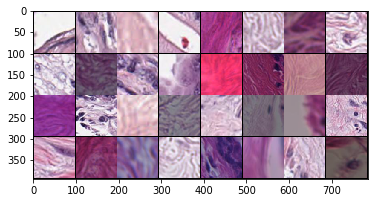

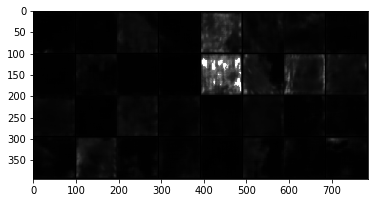

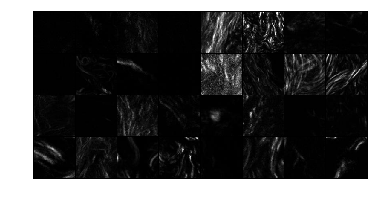

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


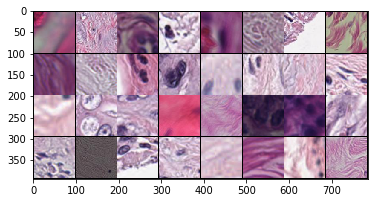

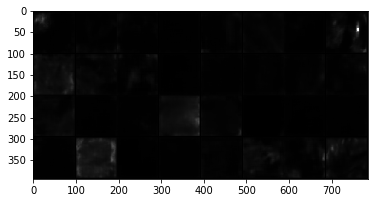

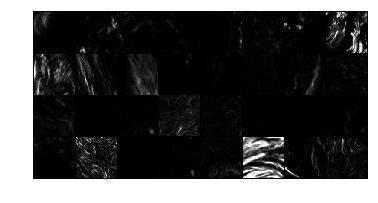

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


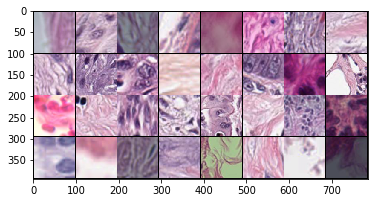

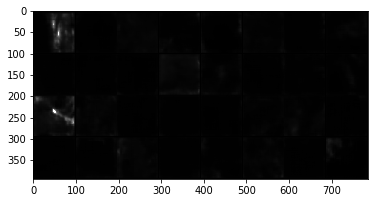

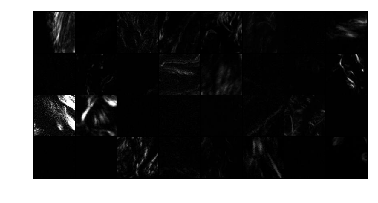

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


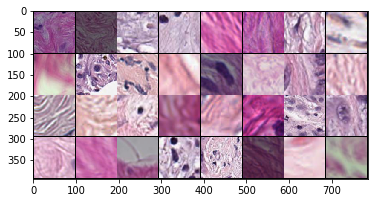

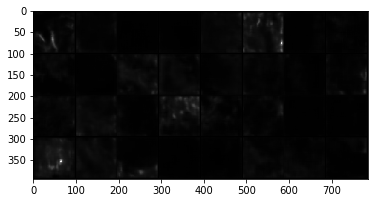

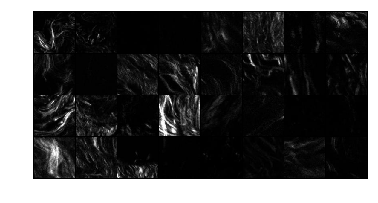

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


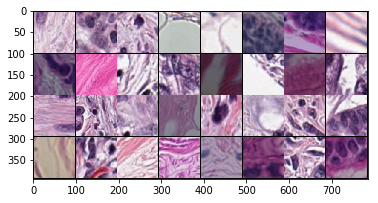

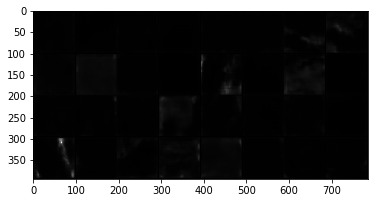

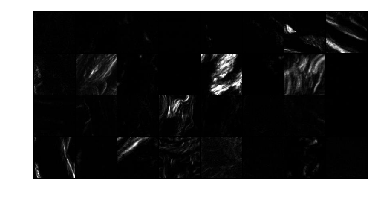

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


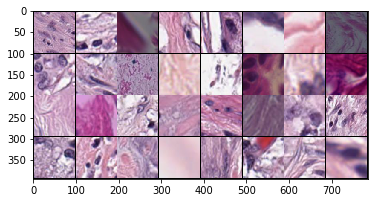

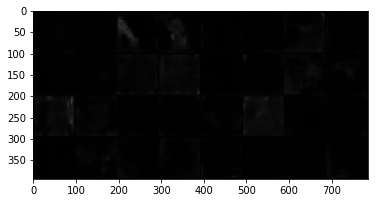

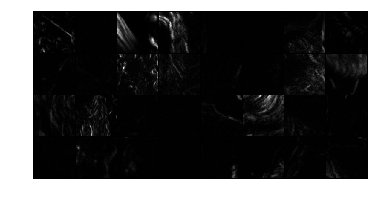

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


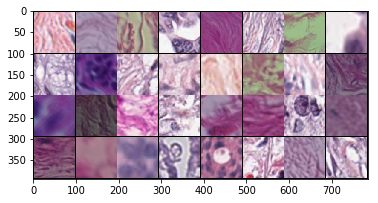

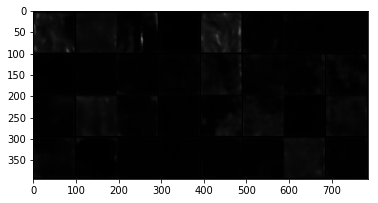

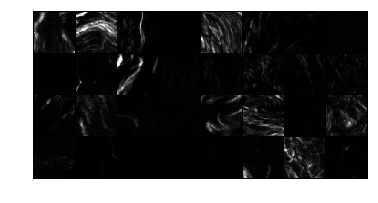

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


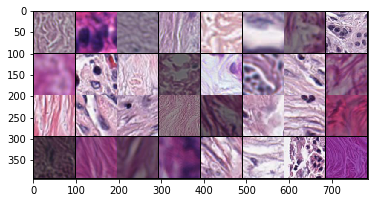

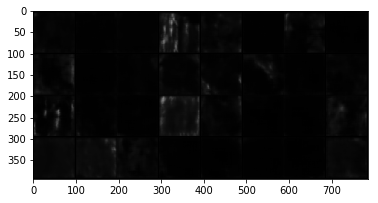

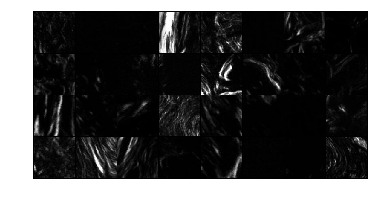

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


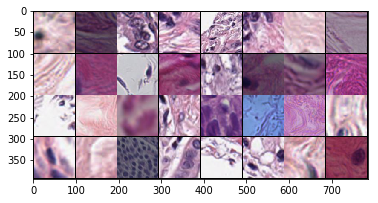

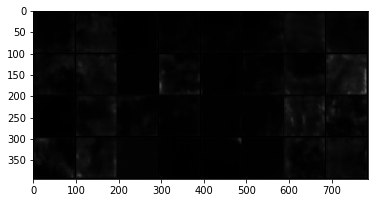

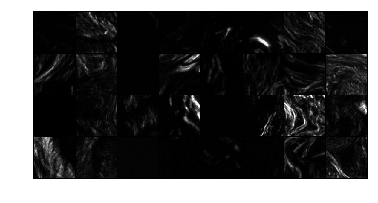

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


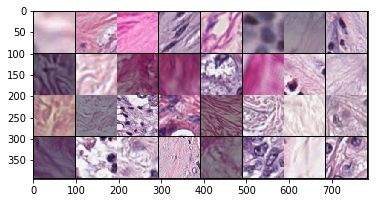

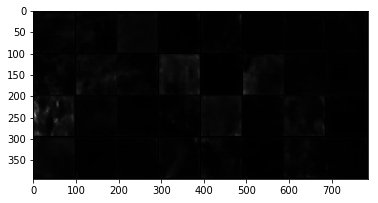

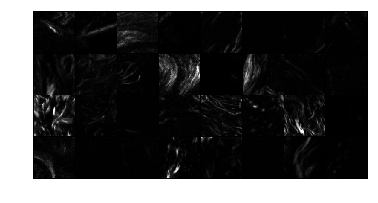

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


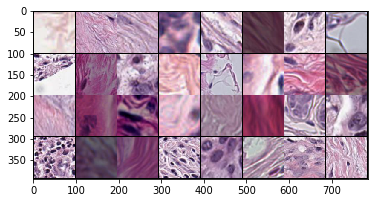

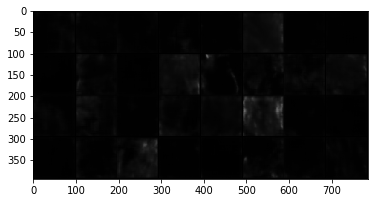

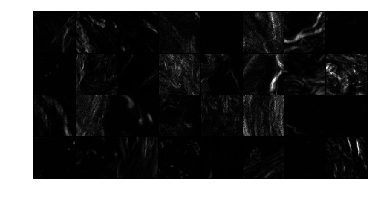

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


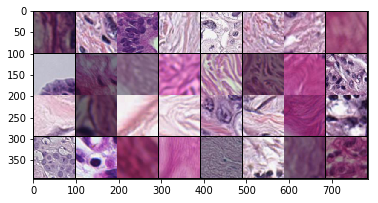

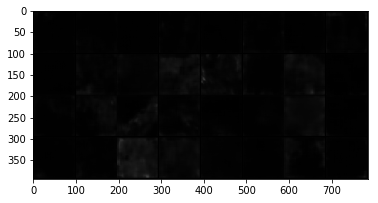

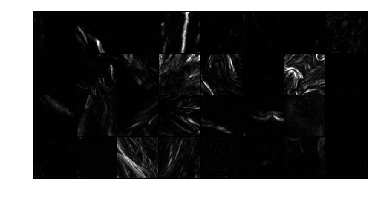

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


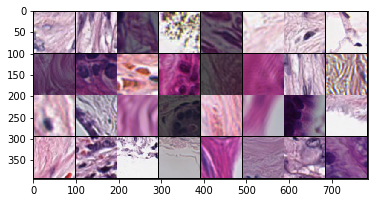

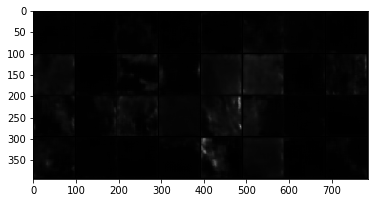

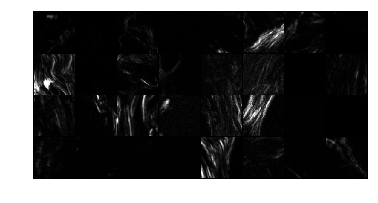

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


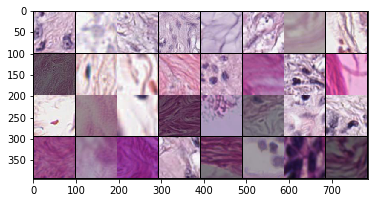

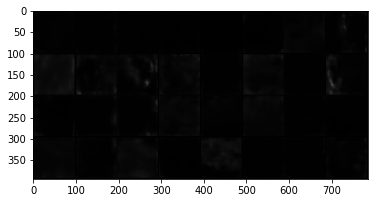

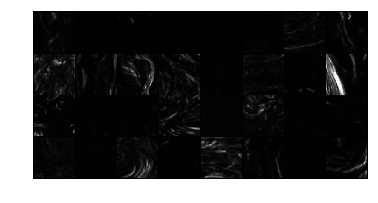

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


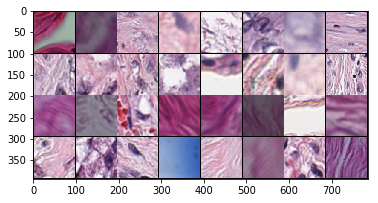

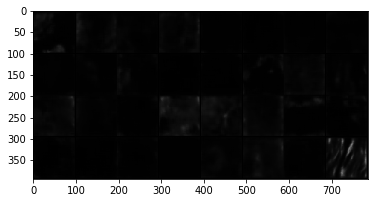

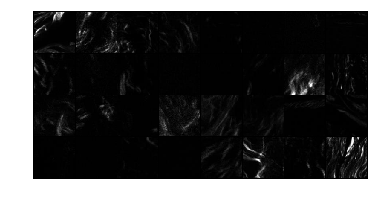

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


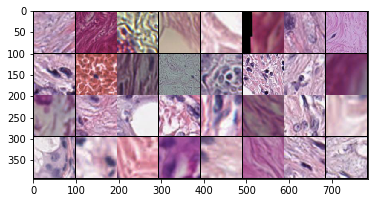

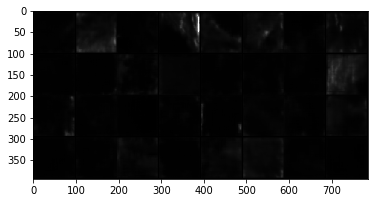

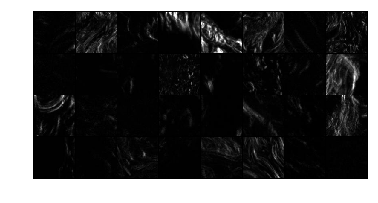

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


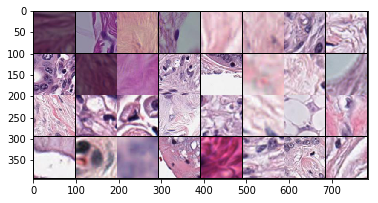

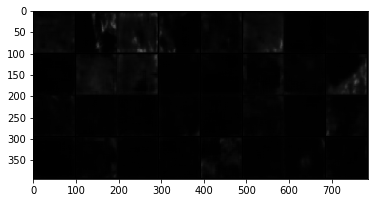

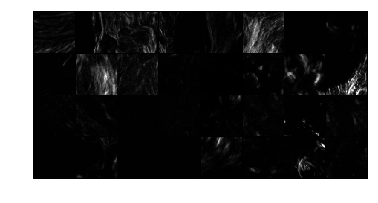

===> Avg. PSNR: nan dB


In [21]:
test()

In [26]:
l = 0.005
p = 0
windowsize = 16
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 16:
            windowsze = 16
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossMSE: 0.004884864203631878 lossSSIM: 0.23496776819229126
===> Epoch[1](0/790): Loss: 0.2350
lossMSE: 0.005937881302088499 lossSSIM: 0.22805404663085938
===> Epoch[1](50/790): Loss: 0.2281
lossMSE: 0.00508984224870801 lossSSIM: 0.22126173973083496
===> Epoch[1](100/790): Loss: 0.2213
lossMSE: 0.004976525437086821 lossSSIM: 0.22116237878799438
===> Epoch[1](150/790): Loss: 0.2212
lossMSE: 0.005322138778865337 lossSSIM: 0.22617191076278687
===> Epoch[1](200/790): Loss: 0.2262
lossMSE: 0.005766252987086773 lossSSIM: 0.23034870624542236
===> Epoch[1](250/790): Loss: 0.2303
lossMSE: 0.005354453809559345 lossSSIM: 0.2191617488861084
===> Epoch[1](300/790): Loss: 0.2192
lossMSE: 0.005996649153530598 lossSSIM: 0.23023056983947754
===> Epoch[1](350/790): Loss: 0.2302
lossMSE: 0.006238467060029507 lossSSIM: 0.2280280590057373
===> Epoch[1](400/790): Loss: 0.2280
lossMSE: 0.0050881351344287395 lossSSIM: 0.22242414951324463
===> Epoch[1](450/790): Loss: 0.2224
lossMSE: 0.00664483243599534 lossSS

lossMSE: 0.006867284420877695 lossSSIM: 0.23428046703338623
===> Epoch[6](150/790): Loss: 0.2343
lossMSE: 0.005062213633209467 lossSSIM: 0.2250150442123413
===> Epoch[6](200/790): Loss: 0.2250
lossMSE: 0.005630695726722479 lossSSIM: 0.21484053134918213
===> Epoch[6](250/790): Loss: 0.2148
lossMSE: 0.005884258076548576 lossSSIM: 0.2207958698272705
===> Epoch[6](300/790): Loss: 0.2208
lossMSE: 0.005863419733941555 lossSSIM: 0.23179346323013306
===> Epoch[6](350/790): Loss: 0.2318
lossMSE: 0.0066138459369540215 lossSSIM: 0.23096537590026855
===> Epoch[6](400/790): Loss: 0.2310
lossMSE: 0.0052571590058505535 lossSSIM: 0.21706783771514893
===> Epoch[6](450/790): Loss: 0.2171
lossMSE: 0.005579248070716858 lossSSIM: 0.23167634010314941
===> Epoch[6](500/790): Loss: 0.2317
lossMSE: 0.005235747434198856 lossSSIM: 0.2254696488380432
===> Epoch[6](550/790): Loss: 0.2255
lossMSE: 0.006074165925383568 lossSSIM: 0.2295493483543396
===> Epoch[6](600/790): Loss: 0.2295
lossMSE: 0.005681909620761871 lo

lossMSE: 0.004711338318884373 lossSSIM: 0.20424741506576538
===> Epoch[11](300/790): Loss: 0.2042
lossMSE: 0.005824757274240255 lossSSIM: 0.22869038581848145
===> Epoch[11](350/790): Loss: 0.2287
lossMSE: 0.004996958188712597 lossSSIM: 0.22798413038253784
===> Epoch[11](400/790): Loss: 0.2280
lossMSE: 0.006255310028791428 lossSSIM: 0.23372983932495117
===> Epoch[11](450/790): Loss: 0.2337
lossMSE: 0.005133007653057575 lossSSIM: 0.22581934928894043
===> Epoch[11](500/790): Loss: 0.2258
lossMSE: 0.0053053610026836395 lossSSIM: 0.21895670890808105
===> Epoch[11](550/790): Loss: 0.2190
lossMSE: 0.0053613148629665375 lossSSIM: 0.2227621078491211
===> Epoch[11](600/790): Loss: 0.2228
lossMSE: 0.0062432619743049145 lossSSIM: 0.23087966442108154
===> Epoch[11](650/790): Loss: 0.2309
lossMSE: 0.006591914687305689 lossSSIM: 0.22711926698684692
===> Epoch[11](700/790): Loss: 0.2271
lossMSE: 0.004951573442667723 lossSSIM: 0.2189406156539917
===> Epoch[11](750/790): Loss: 0.2189
===> Epoch 11 Compl

lossMSE: 0.00512281758710742 lossSSIM: 0.2170606255531311
===> Epoch[16](400/790): Loss: 0.2171
lossMSE: 0.0058590625412762165 lossSSIM: 0.23335152864456177
===> Epoch[16](450/790): Loss: 0.2334
lossMSE: 0.005468735937029123 lossSSIM: 0.22403639554977417
===> Epoch[16](500/790): Loss: 0.2240
lossMSE: 0.0055591086857020855 lossSSIM: 0.22524255514144897
===> Epoch[16](550/790): Loss: 0.2252
lossMSE: 0.005779648199677467 lossSSIM: 0.22273105382919312
===> Epoch[16](600/790): Loss: 0.2227
lossMSE: 0.006443665828555822 lossSSIM: 0.22991055250167847
===> Epoch[16](650/790): Loss: 0.2299
lossMSE: 0.005521255545318127 lossSSIM: 0.2314348816871643
===> Epoch[16](700/790): Loss: 0.2314
lossMSE: 0.005697522312402725 lossSSIM: 0.2178894281387329
===> Epoch[16](750/790): Loss: 0.2179
===> Epoch 16 Complete: Avg. Loss: 0.2254
lossMSE: 0.004492940381169319 lossSSIM: 0.21530425548553467
===> Epoch[17](0/790): Loss: 0.2153
lossMSE: 0.005069042555987835 lossSSIM: 0.2262502908706665
===> Epoch[17](50/790

lossMSE: 0.006553122773766518 lossSSIM: 0.23529058694839478
===> Epoch[21](500/790): Loss: 0.2353
lossMSE: 0.005879781674593687 lossSSIM: 0.2323797345161438
===> Epoch[21](550/790): Loss: 0.2324
lossMSE: 0.005035784561187029 lossSSIM: 0.2195318341255188
===> Epoch[21](600/790): Loss: 0.2195
lossMSE: 0.005001675337553024 lossSSIM: 0.21119368076324463
===> Epoch[21](650/790): Loss: 0.2112
lossMSE: 0.0060369959101080894 lossSSIM: 0.2160395383834839
===> Epoch[21](700/790): Loss: 0.2160
lossMSE: 0.005854714196175337 lossSSIM: 0.22746247053146362
===> Epoch[21](750/790): Loss: 0.2275
===> Epoch 21 Complete: Avg. Loss: 0.2250
lossMSE: 0.005876022856682539 lossSSIM: 0.22906196117401123
===> Epoch[22](0/790): Loss: 0.2291
lossMSE: 0.0052659278735518456 lossSSIM: 0.21845334768295288
===> Epoch[22](50/790): Loss: 0.2185
lossMSE: 0.00666338624432683 lossSSIM: 0.23163223266601562
===> Epoch[22](100/790): Loss: 0.2316
lossMSE: 0.004791393876075745 lossSSIM: 0.22231441736221313
===> Epoch[22](150/79

lossMSE: 0.005798292346298695 lossSSIM: 0.23790842294692993
===> Epoch[26](600/790): Loss: 0.2379
lossMSE: 0.006099910009652376 lossSSIM: 0.23106741905212402
===> Epoch[26](650/790): Loss: 0.2311
lossMSE: 0.0052277022041380405 lossSSIM: 0.21721166372299194
===> Epoch[26](700/790): Loss: 0.2172
lossMSE: 0.00495311850681901 lossSSIM: 0.2173675298690796
===> Epoch[26](750/790): Loss: 0.2174
===> Epoch 26 Complete: Avg. Loss: 0.2247
lossMSE: 0.005286798812448978 lossSSIM: 0.22678136825561523
===> Epoch[27](0/790): Loss: 0.2268
lossMSE: 0.005164919421076775 lossSSIM: 0.22172093391418457
===> Epoch[27](50/790): Loss: 0.2217
lossMSE: 0.006394562311470509 lossSSIM: 0.2275155782699585
===> Epoch[27](100/790): Loss: 0.2275
lossMSE: 0.00520680658519268 lossSSIM: 0.22359412908554077
===> Epoch[27](150/790): Loss: 0.2236
lossMSE: 0.0067794728092849255 lossSSIM: 0.2316046953201294
===> Epoch[27](200/790): Loss: 0.2316
lossMSE: 0.005709923338145018 lossSSIM: 0.22694182395935059
===> Epoch[27](250/790

lossMSE: 0.005784491542726755 lossSSIM: 0.22930669784545898
===> Epoch[31](700/790): Loss: 0.2293
lossMSE: 0.005319364368915558 lossSSIM: 0.2225590944290161
===> Epoch[31](750/790): Loss: 0.2226
===> Epoch 31 Complete: Avg. Loss: 0.2243
lossMSE: 0.005496049765497446 lossSSIM: 0.22499334812164307
===> Epoch[32](0/790): Loss: 0.2250
lossMSE: 0.004923547618091106 lossSSIM: 0.2201094627380371
===> Epoch[32](50/790): Loss: 0.2201
lossMSE: 0.005378298927098513 lossSSIM: 0.22994637489318848
===> Epoch[32](100/790): Loss: 0.2299
lossMSE: 0.005843559745699167 lossSSIM: 0.2308344841003418
===> Epoch[32](150/790): Loss: 0.2308
lossMSE: 0.005283556878566742 lossSSIM: 0.22236591577529907
===> Epoch[32](200/790): Loss: 0.2224
lossMSE: 0.005163045600056648 lossSSIM: 0.21897554397583008
===> Epoch[32](250/790): Loss: 0.2190
lossMSE: 0.005188159644603729 lossSSIM: 0.22016912698745728
===> Epoch[32](300/790): Loss: 0.2202
lossMSE: 0.004798540845513344 lossSSIM: 0.21970438957214355
===> Epoch[32](350/790

===> Epoch 36 Complete: Avg. Loss: 0.2241
lossMSE: 0.005304806865751743 lossSSIM: 0.2126867175102234
===> Epoch[37](0/790): Loss: 0.2127
lossMSE: 0.0053075747564435005 lossSSIM: 0.2239673137664795
===> Epoch[37](50/790): Loss: 0.2240
lossMSE: 0.005640719551593065 lossSSIM: 0.22314143180847168
===> Epoch[37](100/790): Loss: 0.2231
lossMSE: 0.005962619092315435 lossSSIM: 0.21773022413253784
===> Epoch[37](150/790): Loss: 0.2177
lossMSE: 0.006372320465743542 lossSSIM: 0.2368016242980957
===> Epoch[37](200/790): Loss: 0.2368
lossMSE: 0.005686471704393625 lossSSIM: 0.22499829530715942
===> Epoch[37](250/790): Loss: 0.2250
lossMSE: 0.005034312605857849 lossSSIM: 0.2178850769996643
===> Epoch[37](300/790): Loss: 0.2179
lossMSE: 0.005865542218089104 lossSSIM: 0.22361546754837036
===> Epoch[37](350/790): Loss: 0.2236
lossMSE: 0.005191137548536062 lossSSIM: 0.21151584386825562
===> Epoch[37](400/790): Loss: 0.2115
lossMSE: 0.006101175211369991 lossSSIM: 0.23051667213439941
===> Epoch[37](450/790

KeyboardInterrupt: 

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


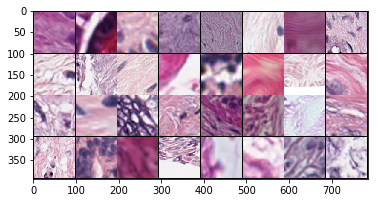

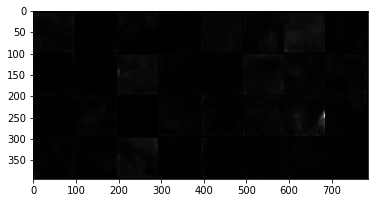

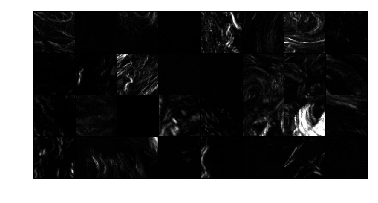

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


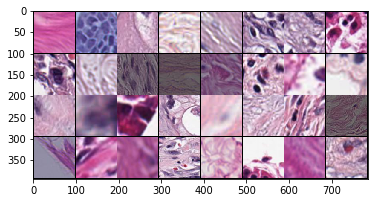

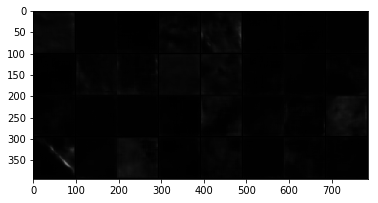

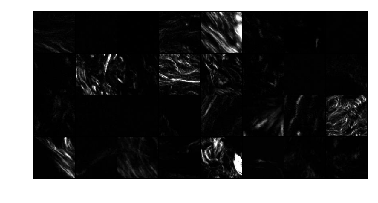

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


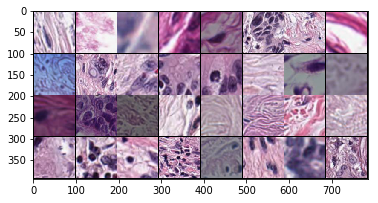

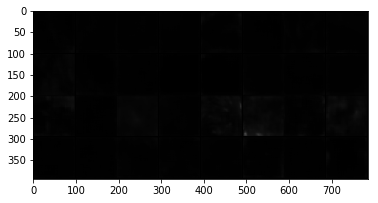

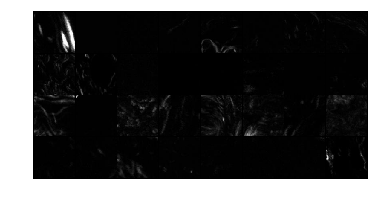

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


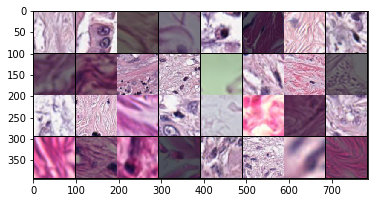

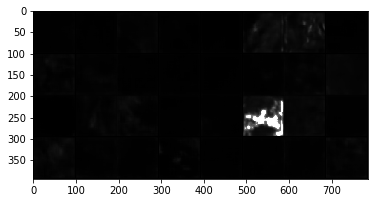

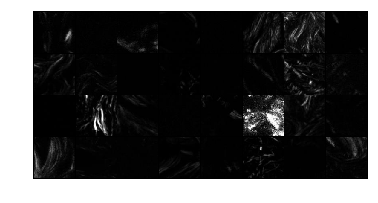

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


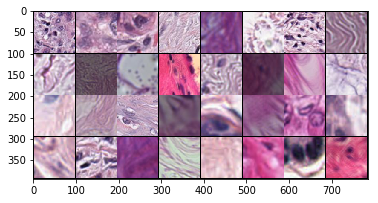

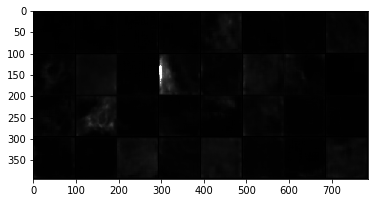

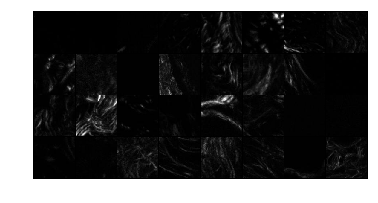

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


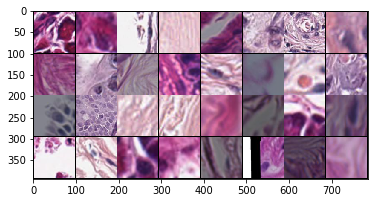

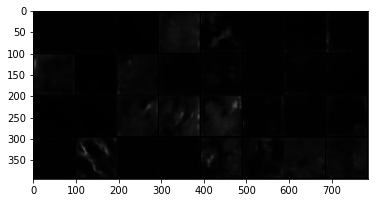

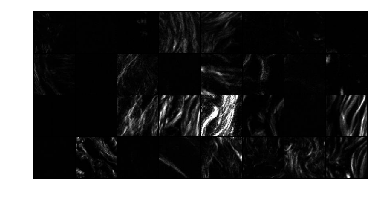

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


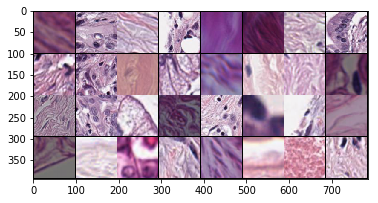

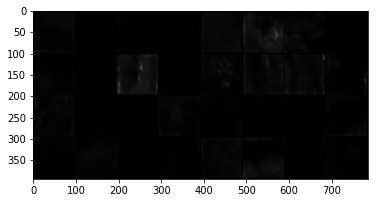

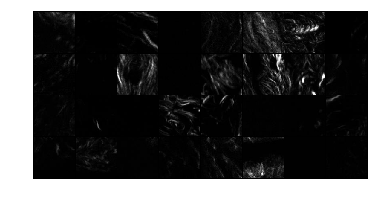

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


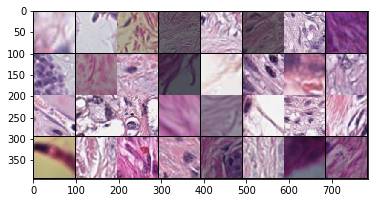

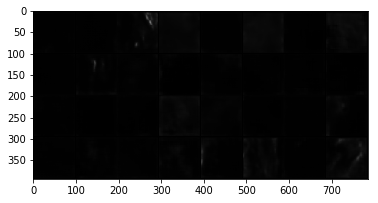

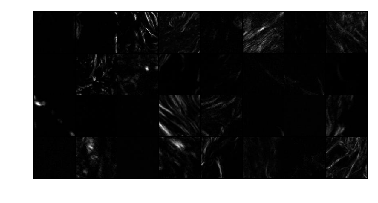

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


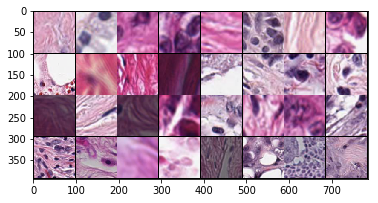

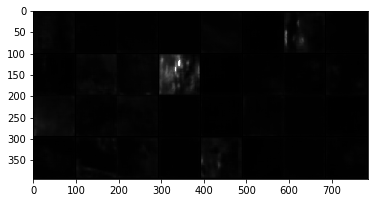

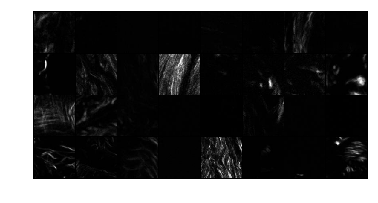

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


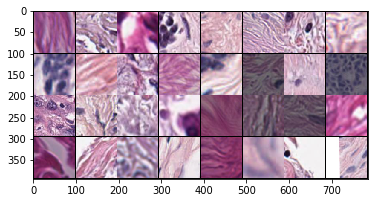

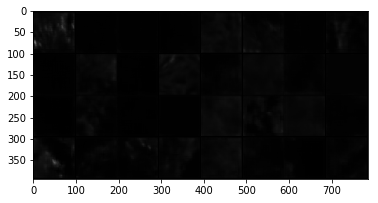

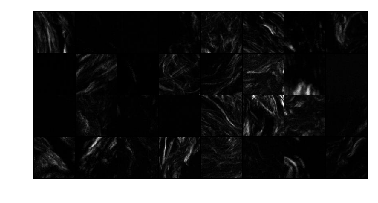

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


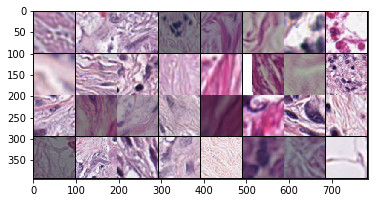

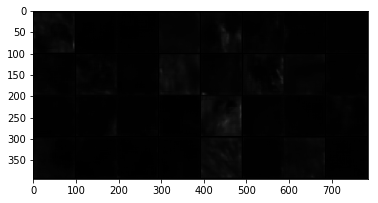

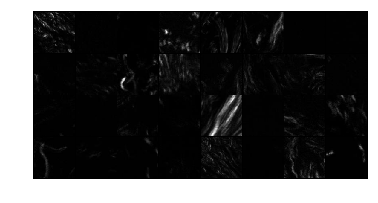

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


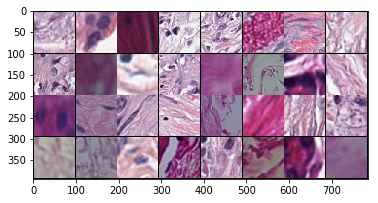

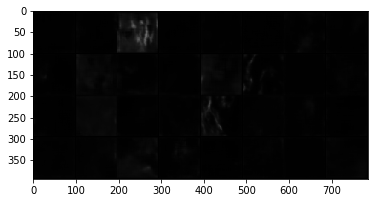

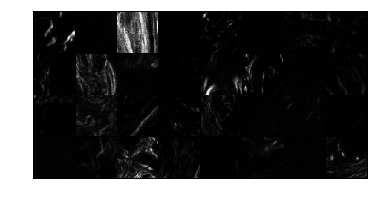

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


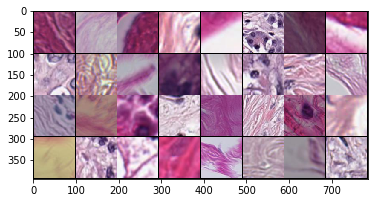

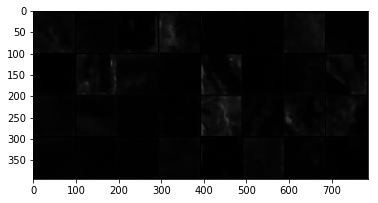

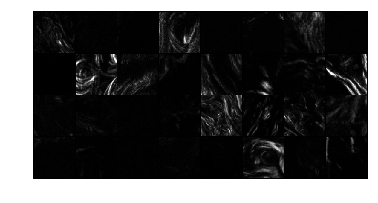

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


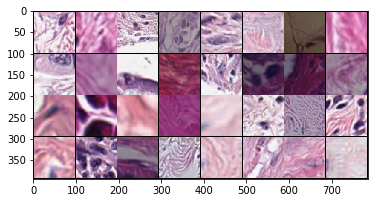

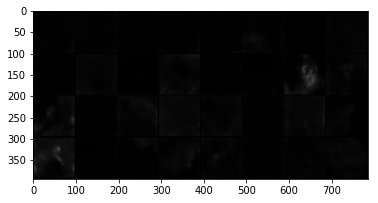

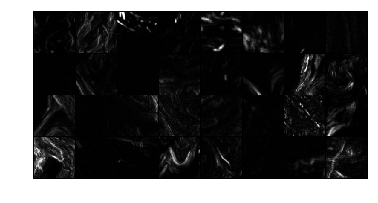

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


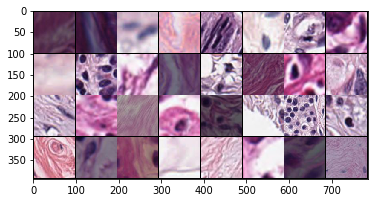

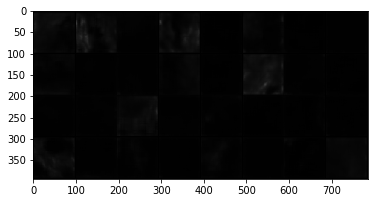

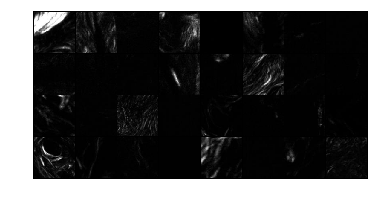

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


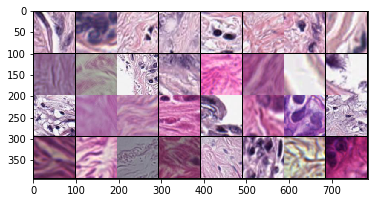

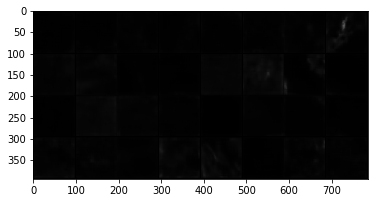

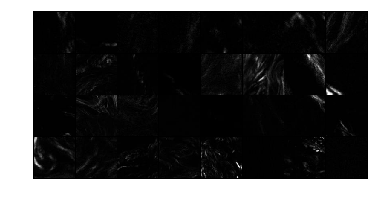

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


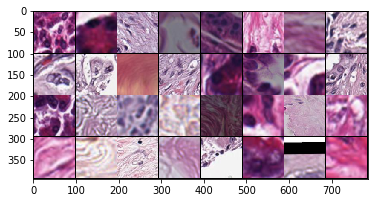

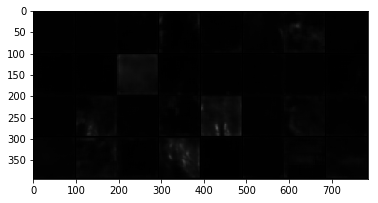

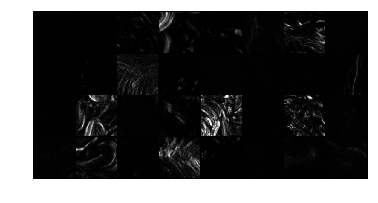

===> Avg. PSNR: nan dB


In [28]:
test()

In [31]:
l = 0.005
p = 0
windowsize = 16
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 16:
            windowsze = 16
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossMSE: 0.005846813321113586 lossSSIM: 0.23727470636367798
===> Epoch[1](0/837): Loss: 0.2373
lossMSE: 0.006199920084327459 lossSSIM: 0.23568648099899292
===> Epoch[1](50/837): Loss: 0.2357
lossMSE: 0.00606965646147728 lossSSIM: 0.23411881923675537
===> Epoch[1](100/837): Loss: 0.2341
lossMSE: 0.007553269620984793 lossSSIM: 0.23860877752304077
===> Epoch[1](150/837): Loss: 0.2386
lossMSE: 0.0057233101688325405 lossSSIM: 0.22754502296447754
===> Epoch[1](200/837): Loss: 0.2275
lossMSE: 0.005798109341412783 lossSSIM: 0.23342913389205933
===> Epoch[1](250/837): Loss: 0.2334
lossMSE: 0.006974309217184782 lossSSIM: 0.24119317531585693
===> Epoch[1](300/837): Loss: 0.2412
lossMSE: 0.005584547761827707 lossSSIM: 0.22712934017181396
===> Epoch[1](350/837): Loss: 0.2271
lossMSE: 0.005778918974101543 lossSSIM: 0.23028379678726196
===> Epoch[1](400/837): Loss: 0.2303
lossMSE: 0.005758881568908691 lossSSIM: 0.22628450393676758
===> Epoch[1](450/837): Loss: 0.2263
lossMSE: 0.0051328279078006744 lo

KeyboardInterrupt: 

In [32]:
import datanewn as dtn

In [35]:
import datanewn as dtn
csvFilePath = dtn.get_csv_path()
transformed_dataset = dtn.HE_SHG_Dataset(csv_file=csvFilePath,
                                               transform=dtn.Compose([                                              
                                               dtn.Rescale(96),                                     
                                               dtn.Normalize(),
                                               dtn.ToTensor()
                                           ]))
# TODO: change the normalization parameters
# batchsize 1200
dataloader = DataLoader(transformed_dataset, batch_size=1200,
                        shuffle=True, num_workers=0)

0 torch.Size([1200, 3, 96, 96]) torch.Size([1200, 96, 96])
1 torch.Size([1200, 3, 96, 96]) torch.Size([1200, 96, 96])
2 torch.Size([1200, 3, 96, 96]) torch.Size([1200, 96, 96])
3 torch.Size([1200, 3, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([1200, 1, 96, 96])


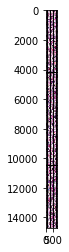

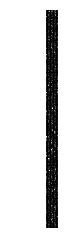

In [34]:
dtn.show_patch(dataloader)

In [36]:
l = 0.005
p = 0.5
windowsize = 16
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 16:
            windowsze = 16
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossMSE: 0.025234337896108627 lossSSIM: 0.8373494148254395
===> Epoch[1](0/837): Loss: 0.4313
lossMSE: 0.012782960198819637 lossSSIM: 0.43124985694885254
===> Epoch[1](50/837): Loss: 0.2220
lossMSE: 0.012570086866617203 lossSSIM: 0.4314579963684082
===> Epoch[1](100/837): Loss: 0.2220
lossMSE: 0.01145867258310318 lossSSIM: 0.4360177516937256
===> Epoch[1](150/837): Loss: 0.2237
lossMSE: 0.010954233817756176 lossSSIM: 0.4352205991744995
===> Epoch[1](200/837): Loss: 0.2231
lossMSE: 0.011165620759129524 lossSSIM: 0.4478541612625122
===> Epoch[1](250/837): Loss: 0.2295
lossMSE: 0.011204098351299763 lossSSIM: 0.42937397956848145
===> Epoch[1](300/837): Loss: 0.2203
lossMSE: 0.010485283099114895 lossSSIM: 0.42513567209243774
===> Epoch[1](350/837): Loss: 0.2178
lossMSE: 0.010568631812930107 lossSSIM: 0.430286169052124
===> Epoch[1](400/837): Loss: 0.2204
lossMSE: 0.0110550532117486 lossSSIM: 0.44406914710998535
===> Epoch[1](450/837): Loss: 0.2276
lossMSE: 0.011889318004250526 lossSSIM: 0.4

KeyboardInterrupt: 

In [37]:
l = 0.005
p = 0.5
windowsize = 8
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 8:
            windowsze = 8
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossMSE: 0.011186999268829823 lossSSIM: 0.43430328369140625
===> Epoch[1](0/837): Loss: 0.2227
lossMSE: 0.010739107616245747 lossSSIM: 0.43004393577575684
===> Epoch[1](50/837): Loss: 0.2204
lossMSE: 0.011416217312216759 lossSSIM: 0.4276643395423889
===> Epoch[1](100/837): Loss: 0.2195
lossMSE: 0.010354987345635891 lossSSIM: 0.4197062849998474
===> Epoch[1](150/837): Loss: 0.2150
lossMSE: 0.01085412222892046 lossSSIM: 0.4349291920661926
===> Epoch[1](200/837): Loss: 0.2229
lossMSE: 0.01031458843499422 lossSSIM: 0.4191075563430786
===> Epoch[1](250/837): Loss: 0.2147
lossMSE: 0.011333013884723186 lossSSIM: 0.4300426244735718
===> Epoch[1](300/837): Loss: 0.2207
lossMSE: 0.01115688681602478 lossSSIM: 0.4316493272781372
===> Epoch[1](350/837): Loss: 0.2214
lossMSE: 0.010838107205927372 lossSSIM: 0.42964333295822144
===> Epoch[1](400/837): Loss: 0.2202
lossMSE: 0.010743493214249611 lossSSIM: 0.4247562289237976
===> Epoch[1](450/837): Loss: 0.2177
lossMSE: 0.010771448723971844 lossSSIM: 0.4

KeyboardInterrupt: 

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


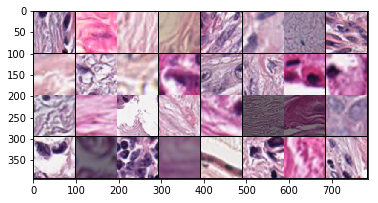

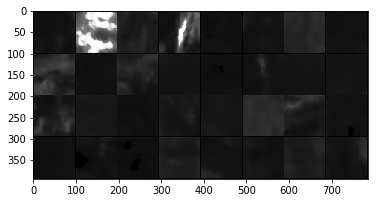

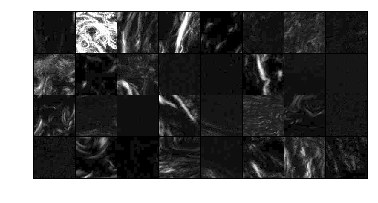

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


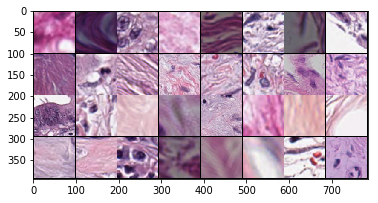

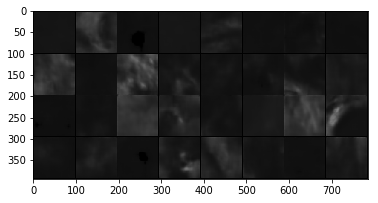

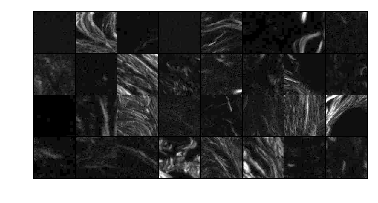

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


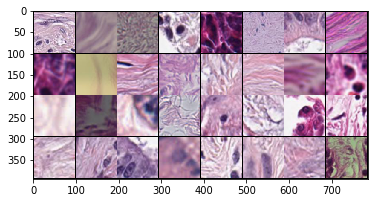

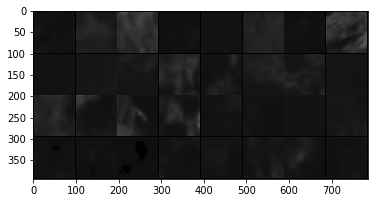

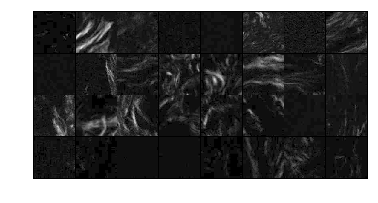

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


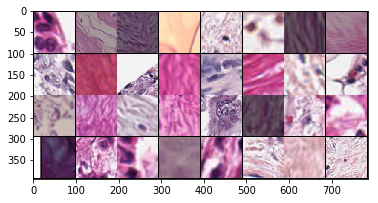

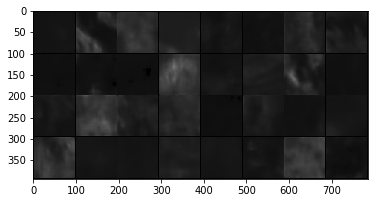

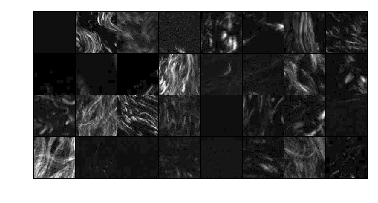

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


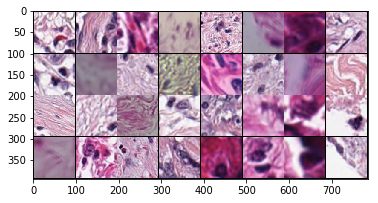

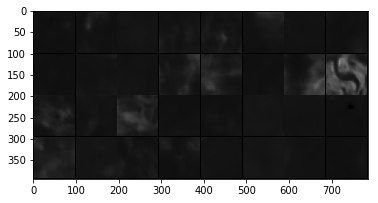

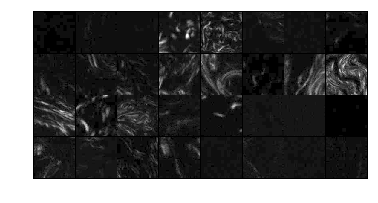

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


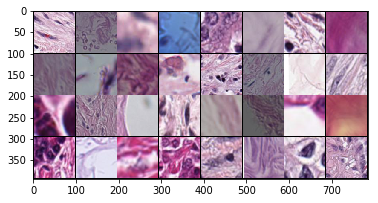

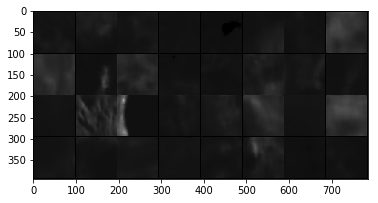

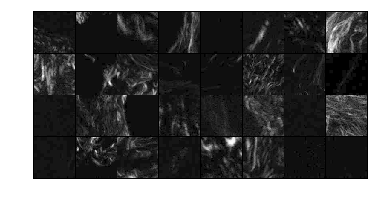

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


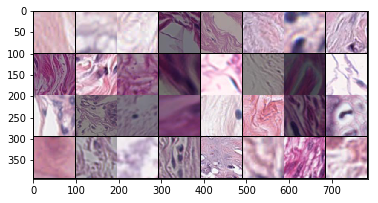

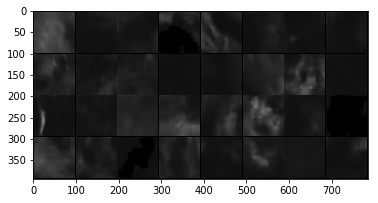

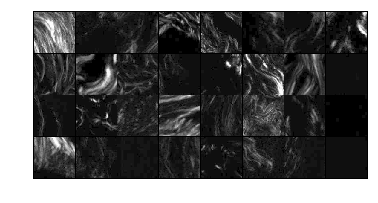

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


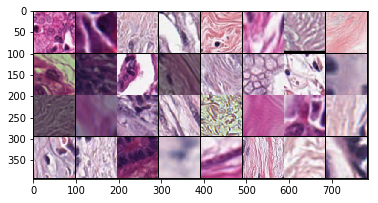

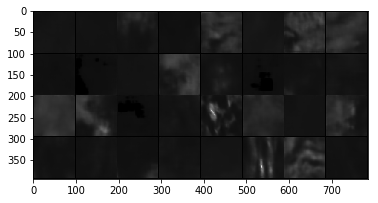

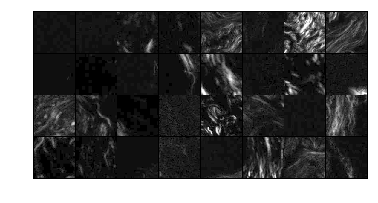

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


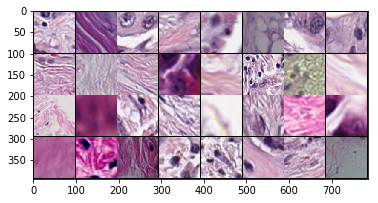

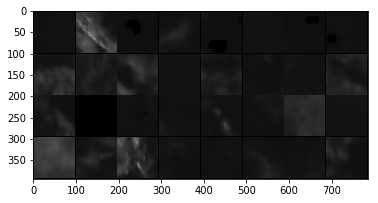

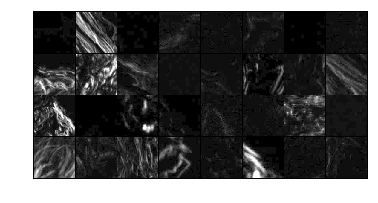

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


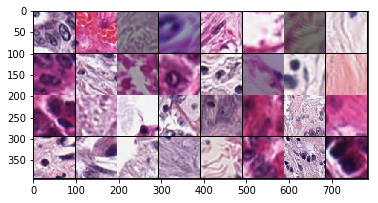

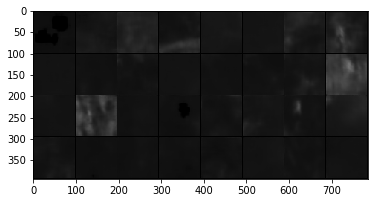

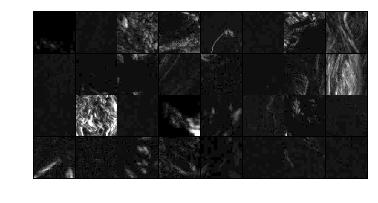

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


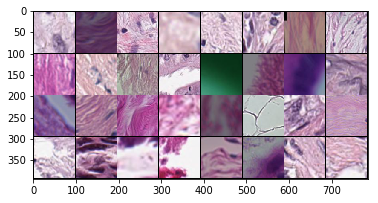

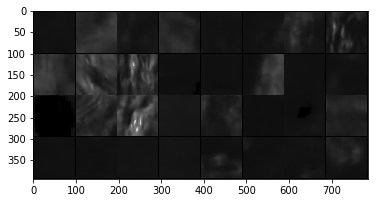

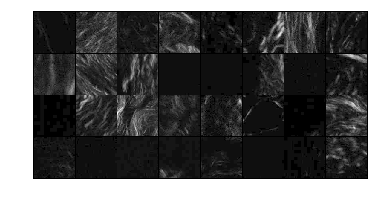

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


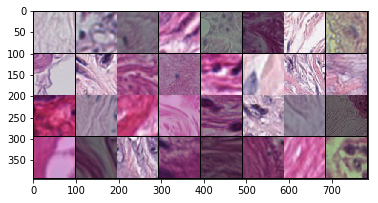

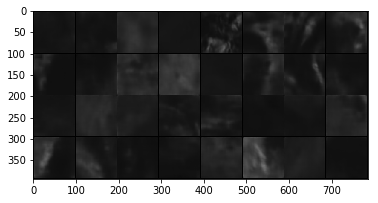

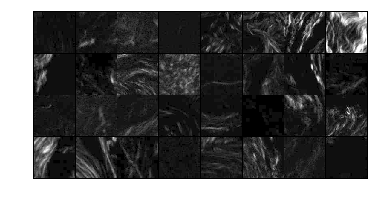

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


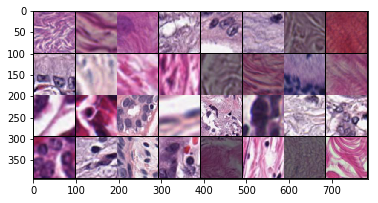

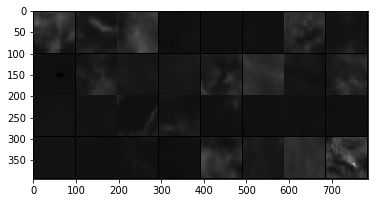

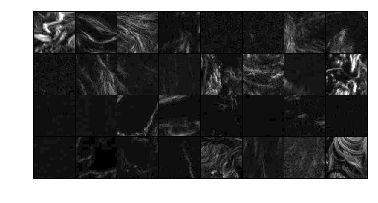

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


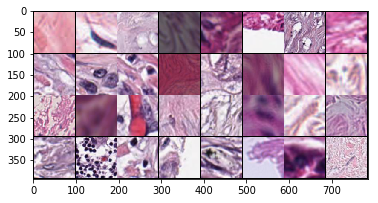

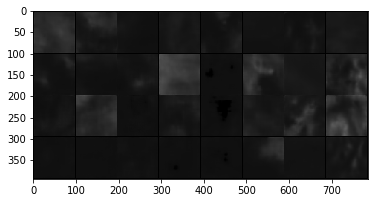

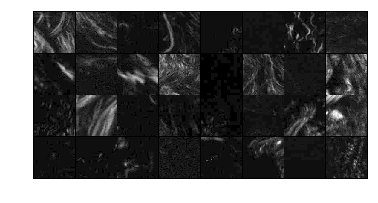

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


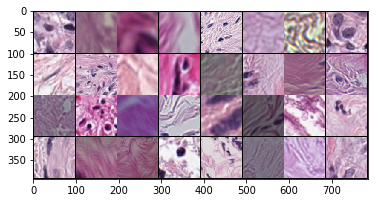

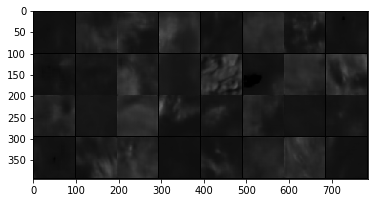

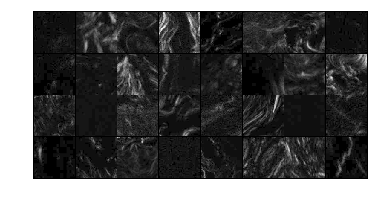

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


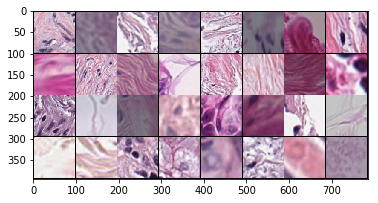

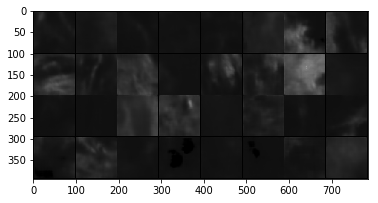

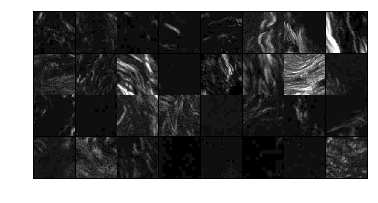

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


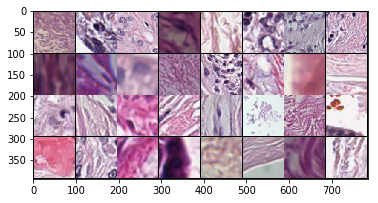

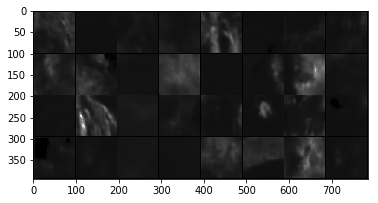

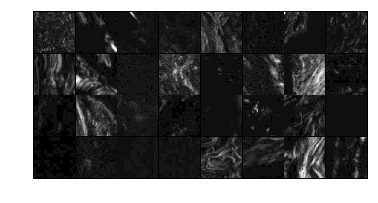

===> Avg. PSNR: nan dB


In [38]:
test()

In [47]:
import os
cwd = os.getcwd();
path = os.path.join(cwd, 'Best model', 'encoderresinfo_0412_1.pth')
torch.save(model.state_dict(), path)

In [40]:
l = 0.005
p = 0.75
windowsize = 8
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 8:
            windowsze = 8
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossMSE: 0.0102450642734766 lossSSIM: 0.42609769105911255
===> Epoch[1](0/837): Loss: 0.1142
lossMSE: 0.00966531503945589 lossSSIM: 0.43111902475357056
===> Epoch[1](50/837): Loss: 0.1150
lossMSE: 0.00982138141989708 lossSSIM: 0.41739940643310547
===> Epoch[1](100/837): Loss: 0.1117
lossMSE: 0.010181179270148277 lossSSIM: 0.421302855014801
===> Epoch[1](150/837): Loss: 0.1130
lossMSE: 0.010064953938126564 lossSSIM: 0.4229506254196167
===> Epoch[1](200/837): Loss: 0.1133
lossMSE: 0.00936749204993248 lossSSIM: 0.4181210994720459
===> Epoch[1](250/837): Loss: 0.1116
lossMSE: 0.010357123799622059 lossSSIM: 0.43028849363327026
===> Epoch[1](300/837): Loss: 0.1153
lossMSE: 0.010832847096025944 lossSSIM: 0.43264275789260864
===> Epoch[1](350/837): Loss: 0.1163
lossMSE: 0.009422038681805134 lossSSIM: 0.41687268018722534
===> Epoch[1](400/837): Loss: 0.1113
lossMSE: 0.01015385426580906 lossSSIM: 0.42532825469970703
===> Epoch[1](450/837): Loss: 0.1139
lossMSE: 0.009949942119419575 lossSSIM: 0.4

KeyboardInterrupt: 

In [41]:
l = 0.005
p = 0
windowsize = 6
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 6:
            windowsze = 6
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossMSE: 0.009830042719841003 lossSSIM: 0.4201968312263489
===> Epoch[1](0/837): Loss: 0.4202
lossMSE: 0.010706611908972263 lossSSIM: 0.41244399547576904
===> Epoch[1](50/837): Loss: 0.4124
lossMSE: 0.00937805138528347 lossSSIM: 0.3999354839324951
===> Epoch[1](100/837): Loss: 0.3999
lossMSE: 0.01047429721802473 lossSSIM: 0.4089251756668091
===> Epoch[1](150/837): Loss: 0.4089
lossMSE: 0.01082870177924633 lossSSIM: 0.41711896657943726
===> Epoch[1](200/837): Loss: 0.4171
lossMSE: 0.011131217703223228 lossSSIM: 0.4236959218978882
===> Epoch[1](250/837): Loss: 0.4237
lossMSE: 0.011562304571270943 lossSSIM: 0.42151737213134766
===> Epoch[1](300/837): Loss: 0.4215
lossMSE: 0.01060143206268549 lossSSIM: 0.41914600133895874
===> Epoch[1](350/837): Loss: 0.4191
lossMSE: 0.011640517972409725 lossSSIM: 0.41471385955810547
===> Epoch[1](400/837): Loss: 0.4147
lossMSE: 0.011397618800401688 lossSSIM: 0.4130502939224243
===> Epoch[1](450/837): Loss: 0.4131
lossMSE: 0.011225203052163124 lossSSIM: 0.

lossMSE: 0.01103649940341711 lossSSIM: 0.4234468936920166
===> Epoch[5](800/837): Loss: 0.4234
===> Epoch 5 Complete: Avg. Loss: 0.4224
lossMSE: 0.011822027154266834 lossSSIM: 0.4204353094100952
===> Epoch[6](0/837): Loss: 0.4204
lossMSE: 0.010422640480101109 lossSSIM: 0.4133939743041992
===> Epoch[6](50/837): Loss: 0.4134
lossMSE: 0.01132588554173708 lossSSIM: 0.42303574085235596
===> Epoch[6](100/837): Loss: 0.4230
lossMSE: 0.011939951218664646 lossSSIM: 0.4263257384300232
===> Epoch[6](150/837): Loss: 0.4263
lossMSE: 0.011053183116018772 lossSSIM: 0.4243800640106201
===> Epoch[6](200/837): Loss: 0.4244
lossMSE: 0.011091265827417374 lossSSIM: 0.4247586131095886
===> Epoch[6](250/837): Loss: 0.4248
lossMSE: 0.011568588204681873 lossSSIM: 0.4230302572250366
===> Epoch[6](300/837): Loss: 0.4230
lossMSE: 0.011320939287543297 lossSSIM: 0.4254812002182007
===> Epoch[6](350/837): Loss: 0.4255
lossMSE: 0.011754119768738747 lossSSIM: 0.4219432473182678
===> Epoch[6](400/837): Loss: 0.4219
los

lossMSE: 0.011838346719741821 lossSSIM: 0.42925459146499634
===> Epoch[10](750/837): Loss: 0.4293
lossMSE: 0.010926569811999798 lossSSIM: 0.4267944097518921
===> Epoch[10](800/837): Loss: 0.4268
===> Epoch 10 Complete: Avg. Loss: 0.4245
lossMSE: 0.009355195797979832 lossSSIM: 0.40833961963653564
===> Epoch[11](0/837): Loss: 0.4083
lossMSE: 0.011906547471880913 lossSSIM: 0.4275361895561218
===> Epoch[11](50/837): Loss: 0.4275
lossMSE: 0.010554404929280281 lossSSIM: 0.4216291308403015
===> Epoch[11](100/837): Loss: 0.4216
lossMSE: 0.011573532596230507 lossSSIM: 0.4251178503036499
===> Epoch[11](150/837): Loss: 0.4251
lossMSE: 0.011168020777404308 lossSSIM: 0.4230839014053345
===> Epoch[11](200/837): Loss: 0.4231
lossMSE: 0.01098957285284996 lossSSIM: 0.4194985032081604
===> Epoch[11](250/837): Loss: 0.4195
lossMSE: 0.011520694009959698 lossSSIM: 0.42198944091796875
===> Epoch[11](300/837): Loss: 0.4220
lossMSE: 0.01090763695538044 lossSSIM: 0.4328359365463257
===> Epoch[11](350/837): Los

KeyboardInterrupt: 

In [45]:
l = 0.001
p = 0.5
windowsize = 8
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 8:
            windowsze = 8
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossL1: 0.05279019847512245 lossSSIM: 0.4195011258125305
===> Epoch[1](0/837): Loss: 0.2361
lossL1: 0.051435913890600204 lossSSIM: 0.41974616050720215
===> Epoch[1](50/837): Loss: 0.2356
lossL1: 0.05546027421951294 lossSSIM: 0.43599700927734375
===> Epoch[1](100/837): Loss: 0.2457
lossL1: 0.05327173322439194 lossSSIM: 0.4226490259170532
===> Epoch[1](150/837): Loss: 0.2380
lossL1: 0.053820669651031494 lossSSIM: 0.42292648553848267
===> Epoch[1](200/837): Loss: 0.2384
lossL1: 0.05532534420490265 lossSSIM: 0.42885202169418335
===> Epoch[1](250/837): Loss: 0.2421
lossL1: 0.053892865777015686 lossSSIM: 0.4222709536552429
===> Epoch[1](300/837): Loss: 0.2381
lossL1: 0.05352851748466492 lossSSIM: 0.4278273582458496
===> Epoch[1](350/837): Loss: 0.2407
lossL1: 0.052140649408102036 lossSSIM: 0.41725021600723267
===> Epoch[1](400/837): Loss: 0.2347
lossL1: 0.05211756005883217 lossSSIM: 0.4252934455871582
===> Epoch[1](450/837): Loss: 0.2387
lossL1: 0.0526970699429512 lossSSIM: 0.421760380268096

KeyboardInterrupt: 

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


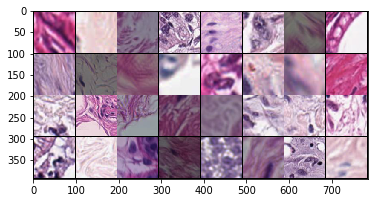

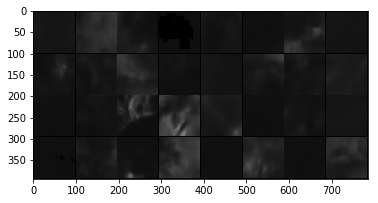

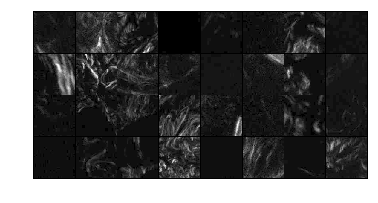

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


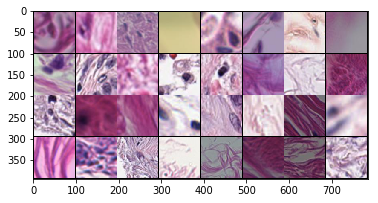

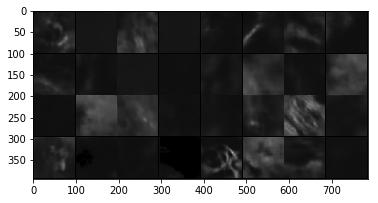

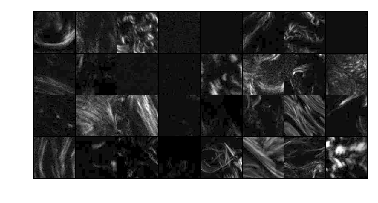

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


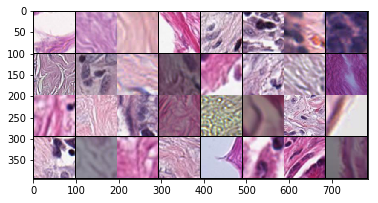

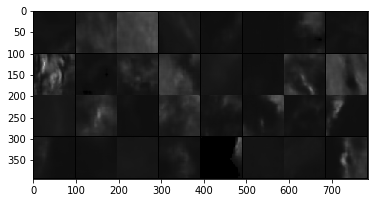

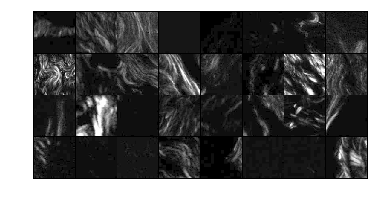

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


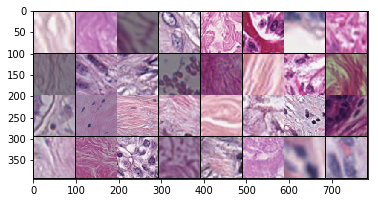

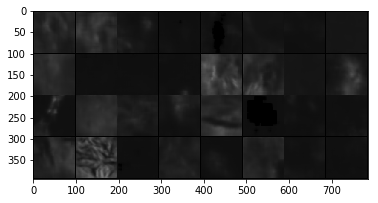

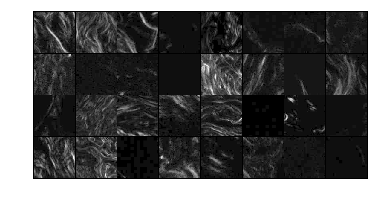

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


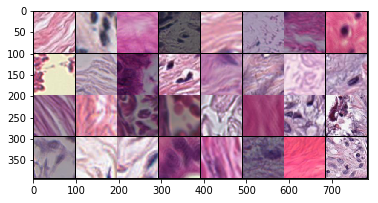

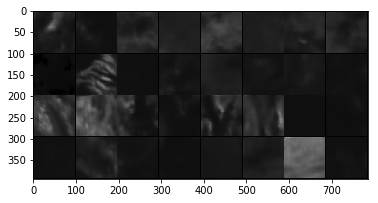

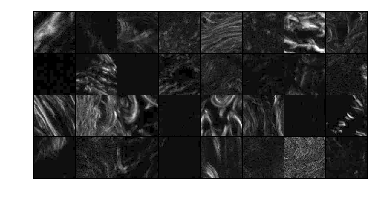

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


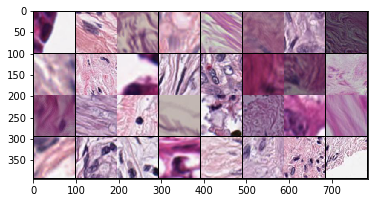

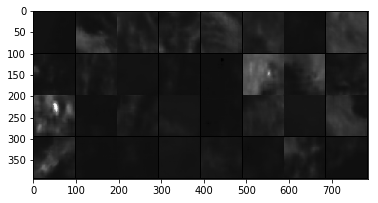

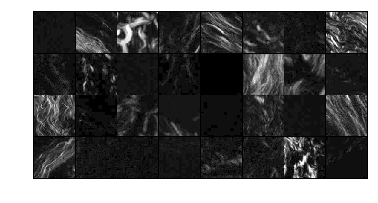

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


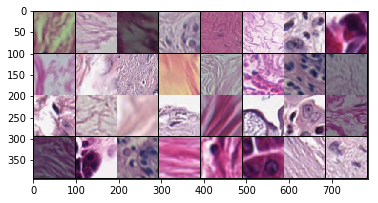

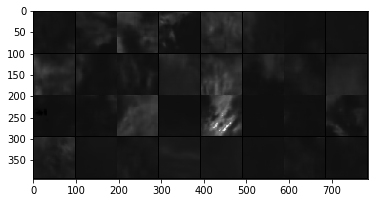

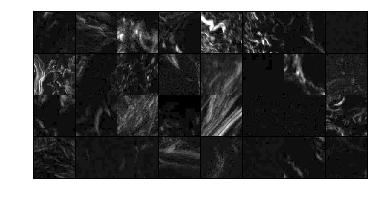

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


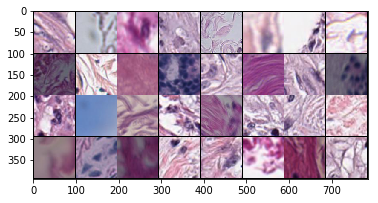

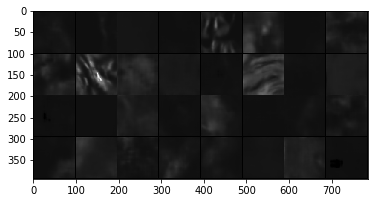

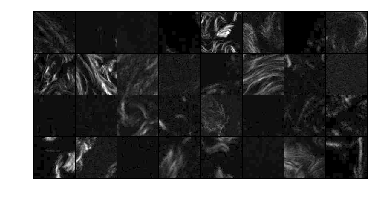

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


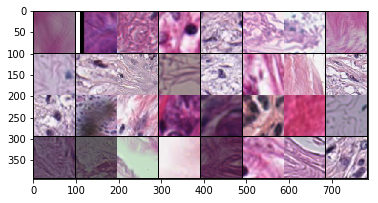

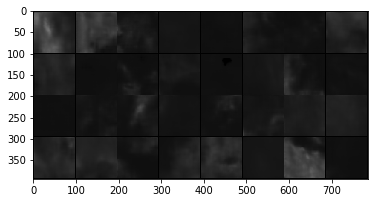

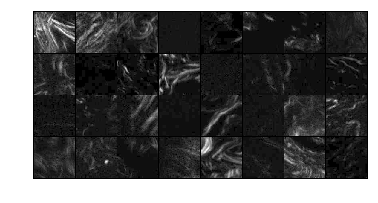

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


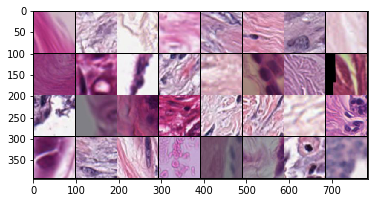

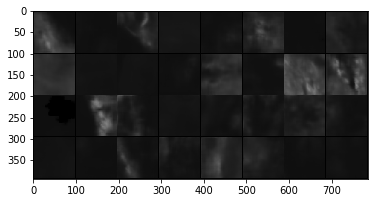

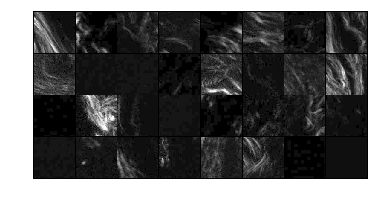

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


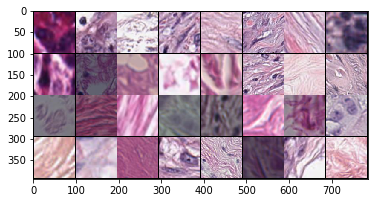

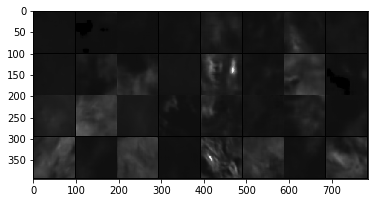

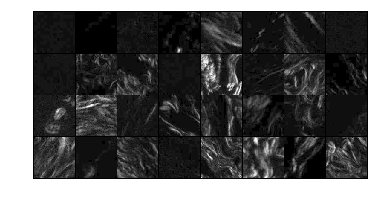

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


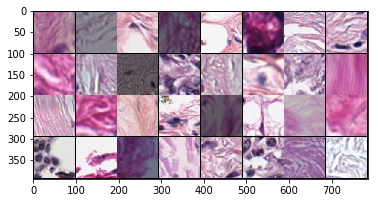

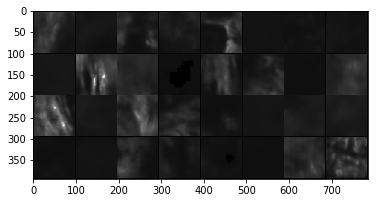

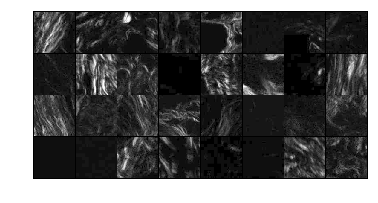

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


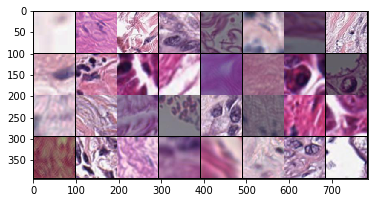

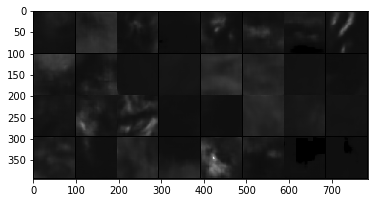

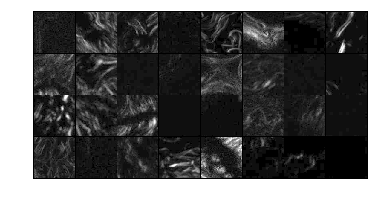

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


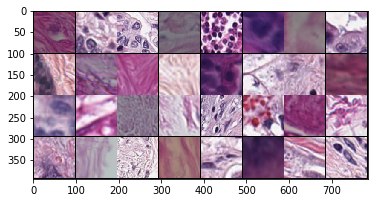

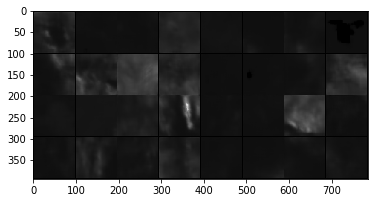

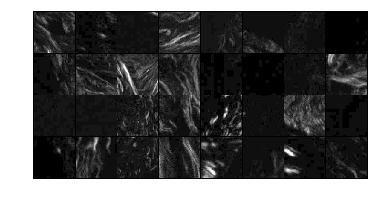

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


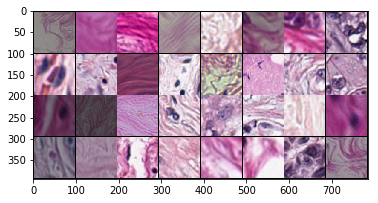

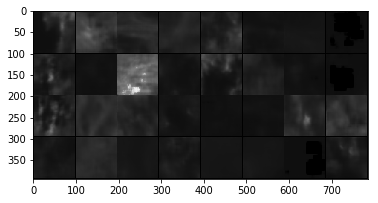

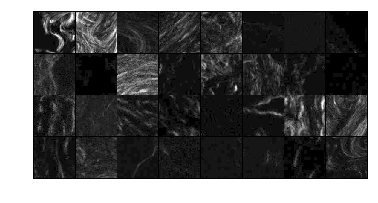

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


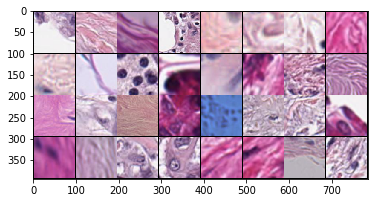

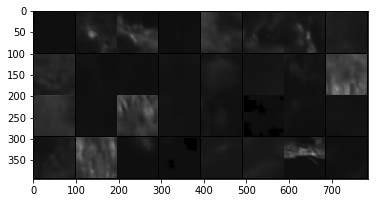

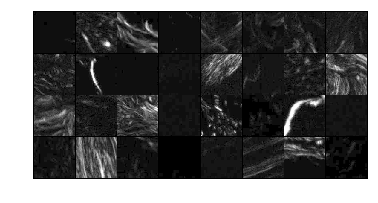

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


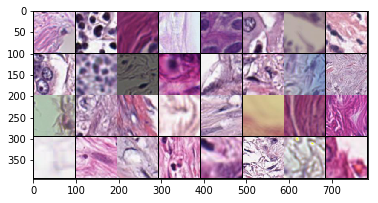

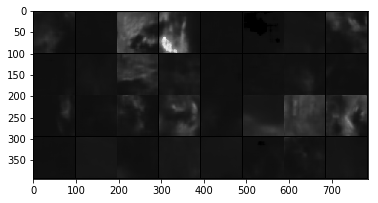

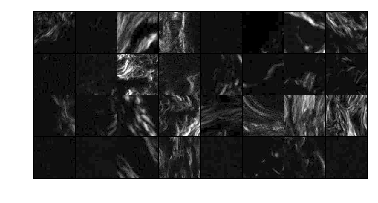

===> Avg. PSNR: nan dB


In [46]:
test()

In [48]:
l = 0.001
p = 0.5
windowsize = 8
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
        if windowsize >= 8:
            windowsze = 8
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossL1: 0.051821041852235794 lossSSIM: 0.41555893421173096
===> Epoch[1](0/837): Loss: 0.2337
lossL1: 0.05140289291739464 lossSSIM: 0.41254210472106934
===> Epoch[1](50/837): Loss: 0.2320
lossL1: 0.05278770625591278 lossSSIM: 0.41652506589889526
===> Epoch[1](100/837): Loss: 0.2347
lossL1: 0.053327109664678574 lossSSIM: 0.42839670181274414
===> Epoch[1](150/837): Loss: 0.2409
lossL1: 0.0546378530561924 lossSSIM: 0.42746758460998535
===> Epoch[1](200/837): Loss: 0.2411
lossL1: 0.05231571942567825 lossSSIM: 0.4213608503341675
===> Epoch[1](250/837): Loss: 0.2368
lossL1: 0.05472257360816002 lossSSIM: 0.4322097897529602
===> Epoch[1](300/837): Loss: 0.2435
lossL1: 0.052829742431640625 lossSSIM: 0.41881251335144043
===> Epoch[1](350/837): Loss: 0.2358
lossL1: 0.05323216691613197 lossSSIM: 0.4251224398612976
===> Epoch[1](400/837): Loss: 0.2392
lossL1: 0.056048743426799774 lossSSIM: 0.4402884840965271
===> Epoch[1](450/837): Loss: 0.2482
lossL1: 0.054799579083919525 lossSSIM: 0.4198762774467

lossL1: 0.05362566187977791 lossSSIM: 0.42455875873565674
===> Epoch[6](0/837): Loss: 0.2391
lossL1: 0.05394637584686279 lossSSIM: 0.43069106340408325
===> Epoch[6](50/837): Loss: 0.2423
lossL1: 0.055046577006578445 lossSSIM: 0.42817795276641846
===> Epoch[6](100/837): Loss: 0.2416
lossL1: 0.05029783025383949 lossSSIM: 0.4131616950035095
===> Epoch[6](150/837): Loss: 0.2317
lossL1: 0.05393392592668533 lossSSIM: 0.4350426197052002
===> Epoch[6](200/837): Loss: 0.2445
lossL1: 0.05206042900681496 lossSSIM: 0.4136051535606384
===> Epoch[6](250/837): Loss: 0.2328
lossL1: 0.05143177881836891 lossSSIM: 0.414417564868927
===> Epoch[6](300/837): Loss: 0.2329
lossL1: 0.052510250359773636 lossSSIM: 0.41989046335220337
===> Epoch[6](350/837): Loss: 0.2362
lossL1: 0.051276471465826035 lossSSIM: 0.40795522928237915
===> Epoch[6](400/837): Loss: 0.2296
lossL1: 0.05295729637145996 lossSSIM: 0.42043042182922363
===> Epoch[6](450/837): Loss: 0.2367
lossL1: 0.052673712372779846 lossSSIM: 0.41994714736938

KeyboardInterrupt: 

In [53]:
import dataaug as dta
csvFilePath = dta.get_csv_path()
transformed_datasetH = dta.HE_SHG_Dataset(csv_file=csvFilePath,
                                               transform=dta.Compose([                                              
                                               dta.Rescale(96),                                     
                                               dta.Normalize(),
                                               dta.FlipH(),
                                               dta.ToTensor()
                                           ]))
transformed_datasetV = dta.HE_SHG_Dataset(csv_file=csvFilePath,
                                               transform=dta.Compose([                                              
                                               dta.Rescale(96),                                     
                                               dta.Normalize(),
                                               dta.FlipV(),
                                               dta.ToTensor()
                                           ]))
transformed_dataset = dta.HE_SHG_Dataset(csv_file=csvFilePath,
                                               transform=dta.Compose([                                              
                                               dta.Rescale(96),                                     
                                               dta.Normalize(),
                                               dta.ToTensor()
                                           ]))
dataset = ConcatDataset((transformed_datasetH, transformed_datasetV, transformed_dataset))
dataloader = DataLoader(dataset, batch_size=1200,
                        shuffle=True, num_workers=0)
print(len(dataset))

3012972


In [54]:
l = 0.0001
p = 0.5
windowsize = 9
for epoch in range(1, 200 + 1):
    if epoch%5 == 0:
        windowsize = windowsize+1
        p = p*1
        l = l*1
    optimizer = optim.Adam(model.parameters(), lr=l)
        
    train(epoch, p, windowsize)

lossL1: 0.054433904588222504 lossSSIM: 0.43302321434020996
===> Epoch[1](0/2511): Loss: 0.2437
lossL1: 0.05614915117621422 lossSSIM: 0.43451279401779175
===> Epoch[1](50/2511): Loss: 0.2453
lossL1: 0.05397737771272659 lossSSIM: 0.4270995855331421
===> Epoch[1](100/2511): Loss: 0.2405
lossL1: 0.056438129395246506 lossSSIM: 0.43716931343078613
===> Epoch[1](150/2511): Loss: 0.2468
lossL1: 0.05495532602071762 lossSSIM: 0.4287896752357483
===> Epoch[1](200/2511): Loss: 0.2419
lossL1: 0.05551322177052498 lossSSIM: 0.4291439652442932
===> Epoch[1](250/2511): Loss: 0.2423
lossL1: 0.053249455988407135 lossSSIM: 0.42171919345855713
===> Epoch[1](300/2511): Loss: 0.2375
lossL1: 0.055132560431957245 lossSSIM: 0.436077356338501
===> Epoch[1](350/2511): Loss: 0.2456
lossL1: 0.055691156536340714 lossSSIM: 0.4418952465057373
===> Epoch[1](400/2511): Loss: 0.2488
lossL1: 0.053897373378276825 lossSSIM: 0.4261484146118164
===> Epoch[1](450/2511): Loss: 0.2400
lossL1: 0.0583263635635376 lossSSIM: 0.45256

lossL1: 0.056584782898426056 lossSSIM: 0.4382812976837158
===> Epoch[2](1700/2511): Loss: 0.2474
lossL1: 0.05246702954173088 lossSSIM: 0.4184153079986572
===> Epoch[2](1750/2511): Loss: 0.2354
lossL1: 0.0525381825864315 lossSSIM: 0.42344921827316284
===> Epoch[2](1800/2511): Loss: 0.2380
lossL1: 0.057976193726062775 lossSSIM: 0.4480130672454834
===> Epoch[2](1850/2511): Loss: 0.2530
lossL1: 0.0559232123196125 lossSSIM: 0.4365512728691101
===> Epoch[2](1900/2511): Loss: 0.2462
lossL1: 0.0552930012345314 lossSSIM: 0.4354294538497925
===> Epoch[2](1950/2511): Loss: 0.2454
lossL1: 0.054256513714790344 lossSSIM: 0.42726820707321167
===> Epoch[2](2000/2511): Loss: 0.2408
lossL1: 0.055907394737005234 lossSSIM: 0.4260774254798889
===> Epoch[2](2050/2511): Loss: 0.2410
lossL1: 0.0544845350086689 lossSSIM: 0.4274505376815796
===> Epoch[2](2100/2511): Loss: 0.2410
lossL1: 0.05500655621290207 lossSSIM: 0.43368756771087646
===> Epoch[2](2150/2511): Loss: 0.2443
lossL1: 0.056425102055072784 lossSSIM

lossL1: 0.05481692776083946 lossSSIM: 0.4237486720085144
===> Epoch[4](850/2511): Loss: 0.2393
lossL1: 0.05518370494246483 lossSSIM: 0.4279062747955322
===> Epoch[4](900/2511): Loss: 0.2415
lossL1: 0.055914364755153656 lossSSIM: 0.4295133352279663
===> Epoch[4](950/2511): Loss: 0.2427
lossL1: 0.05507378652691841 lossSSIM: 0.4319522976875305
===> Epoch[4](1000/2511): Loss: 0.2435
lossL1: 0.054676201194524765 lossSSIM: 0.43080073595046997
===> Epoch[4](1050/2511): Loss: 0.2427
lossL1: 0.05642012879252434 lossSSIM: 0.43925750255584717
===> Epoch[4](1100/2511): Loss: 0.2478
lossL1: 0.05169075354933739 lossSSIM: 0.41035932302474976
===> Epoch[4](1150/2511): Loss: 0.2310
lossL1: 0.05492508038878441 lossSSIM: 0.4383552670478821
===> Epoch[4](1200/2511): Loss: 0.2466
lossL1: 0.05630306154489517 lossSSIM: 0.42878997325897217
===> Epoch[4](1250/2511): Loss: 0.2425
lossL1: 0.054658446460962296 lossSSIM: 0.4323538541793823
===> Epoch[4](1300/2511): Loss: 0.2435
lossL1: 0.05331537500023842 lossSSIM

===> Epoch 5 Complete: Avg. Loss: 0.2425
lossL1: 0.05520574003458023 lossSSIM: 0.4286552667617798
===> Epoch[6](0/2511): Loss: 0.2419
lossL1: 0.05482034012675285 lossSSIM: 0.43223828077316284
===> Epoch[6](50/2511): Loss: 0.2435
lossL1: 0.05289820209145546 lossSSIM: 0.42292773723602295
===> Epoch[6](100/2511): Loss: 0.2379
lossL1: 0.05627012625336647 lossSSIM: 0.44835060834884644
===> Epoch[6](150/2511): Loss: 0.2523
lossL1: 0.05545787140727043 lossSSIM: 0.43254780769348145
===> Epoch[6](200/2511): Loss: 0.2440
lossL1: 0.05547032132744789 lossSSIM: 0.43678271770477295
===> Epoch[6](250/2511): Loss: 0.2461
lossL1: 0.05434531345963478 lossSSIM: 0.4340856671333313
===> Epoch[6](300/2511): Loss: 0.2442
lossL1: 0.05398876219987869 lossSSIM: 0.4272690415382385
===> Epoch[6](350/2511): Loss: 0.2406
lossL1: 0.05256444960832596 lossSSIM: 0.4186899662017822
===> Epoch[6](400/2511): Loss: 0.2356
lossL1: 0.05383310467004776 lossSSIM: 0.42289119958877563
===> Epoch[6](450/2511): Loss: 0.2384
lossL1

lossL1: 0.052291762083768845 lossSSIM: 0.4201275110244751
===> Epoch[7](1700/2511): Loss: 0.2362
lossL1: 0.05401472747325897 lossSSIM: 0.42910248041152954
===> Epoch[7](1750/2511): Loss: 0.2416
lossL1: 0.05537325143814087 lossSSIM: 0.4290230870246887
===> Epoch[7](1800/2511): Loss: 0.2422
lossL1: 0.0516761876642704 lossSSIM: 0.4230928421020508
===> Epoch[7](1850/2511): Loss: 0.2374
lossL1: 0.055566441267728806 lossSSIM: 0.43823307752609253
===> Epoch[7](1900/2511): Loss: 0.2469
lossL1: 0.054571669548749924 lossSSIM: 0.43049389123916626
===> Epoch[7](1950/2511): Loss: 0.2425
lossL1: 0.0536622628569603 lossSSIM: 0.42607349157333374
===> Epoch[7](2000/2511): Loss: 0.2399
lossL1: 0.05465521290898323 lossSSIM: 0.43413299322128296
===> Epoch[7](2050/2511): Loss: 0.2444
lossL1: 0.056584082543849945 lossSSIM: 0.4356304407119751
===> Epoch[7](2100/2511): Loss: 0.2461
lossL1: 0.054595258086919785 lossSSIM: 0.42935341596603394
===> Epoch[7](2150/2511): Loss: 0.2420
lossL1: 0.05392438545823097 los

lossL1: 0.052581243216991425 lossSSIM: 0.42477500438690186
===> Epoch[9](850/2511): Loss: 0.2387
lossL1: 0.05533287301659584 lossSSIM: 0.4372488856315613
===> Epoch[9](900/2511): Loss: 0.2463
lossL1: 0.05514008179306984 lossSSIM: 0.4276161193847656
===> Epoch[9](950/2511): Loss: 0.2414
lossL1: 0.054494984447956085 lossSSIM: 0.43377113342285156
===> Epoch[9](1000/2511): Loss: 0.2441
lossL1: 0.05337802320718765 lossSSIM: 0.4249727129936218
===> Epoch[9](1050/2511): Loss: 0.2392
lossL1: 0.05331070348620415 lossSSIM: 0.4275825619697571
===> Epoch[9](1100/2511): Loss: 0.2404
lossL1: 0.054885994642972946 lossSSIM: 0.43677085638046265
===> Epoch[9](1150/2511): Loss: 0.2458
lossL1: 0.05443735793232918 lossSSIM: 0.43080705404281616
===> Epoch[9](1200/2511): Loss: 0.2426
lossL1: 0.05394378677010536 lossSSIM: 0.42563265562057495
===> Epoch[9](1250/2511): Loss: 0.2398
lossL1: 0.054673872888088226 lossSSIM: 0.4387442469596863
===> Epoch[9](1300/2511): Loss: 0.2467
lossL1: 0.05269470065832138 lossSS

===> Epoch 10 Complete: Avg. Loss: 0.2425
lossL1: 0.05196494609117508 lossSSIM: 0.4157748222351074
===> Epoch[11](0/2511): Loss: 0.2339
lossL1: 0.05543762072920799 lossSSIM: 0.43619441986083984
===> Epoch[11](50/2511): Loss: 0.2458
lossL1: 0.055743005126714706 lossSSIM: 0.43724924325942993
===> Epoch[11](100/2511): Loss: 0.2465
lossL1: 0.055894408375024796 lossSSIM: 0.4426400661468506
===> Epoch[11](150/2511): Loss: 0.2493
lossL1: 0.057882729917764664 lossSSIM: 0.43939000368118286
===> Epoch[11](200/2511): Loss: 0.2486
lossL1: 0.053503382951021194 lossSSIM: 0.41625308990478516
===> Epoch[11](250/2511): Loss: 0.2349
lossL1: 0.053554948419332504 lossSSIM: 0.4294949769973755
===> Epoch[11](300/2511): Loss: 0.2415
lossL1: 0.05405992269515991 lossSSIM: 0.42604535818099976
===> Epoch[11](350/2511): Loss: 0.2401
lossL1: 0.05542122200131416 lossSSIM: 0.4357052445411682
===> Epoch[11](400/2511): Loss: 0.2456
lossL1: 0.054348964244127274 lossSSIM: 0.4317161440849304
===> Epoch[11](450/2511): Los

lossL1: 0.051587123423814774 lossSSIM: 0.4098936915397644
===> Epoch[12](1650/2511): Loss: 0.2307
lossL1: 0.05387471616268158 lossSSIM: 0.4277060627937317
===> Epoch[12](1700/2511): Loss: 0.2408
lossL1: 0.05392628535628319 lossSSIM: 0.4279465079307556
===> Epoch[12](1750/2511): Loss: 0.2409
lossL1: 0.05543481186032295 lossSSIM: 0.4417533278465271
===> Epoch[12](1800/2511): Loss: 0.2486
lossL1: 0.05561431869864464 lossSSIM: 0.4386765956878662
===> Epoch[12](1850/2511): Loss: 0.2471
lossL1: 0.054569877684116364 lossSSIM: 0.4291839003562927
===> Epoch[12](1900/2511): Loss: 0.2419
lossL1: 0.05364619567990303 lossSSIM: 0.4244258999824524
===> Epoch[12](1950/2511): Loss: 0.2390
lossL1: 0.05396900698542595 lossSSIM: 0.42788463830947876
===> Epoch[12](2000/2511): Loss: 0.2409
lossL1: 0.0547073595225811 lossSSIM: 0.44755446910858154
===> Epoch[12](2050/2511): Loss: 0.2511
lossL1: 0.054338809102773666 lossSSIM: 0.4360405206680298
===> Epoch[12](2100/2511): Loss: 0.2452
lossL1: 0.0546342581510543

KeyboardInterrupt: 

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


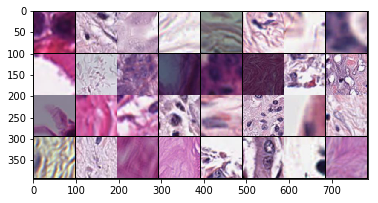

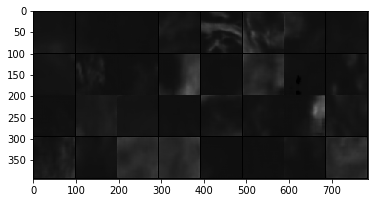

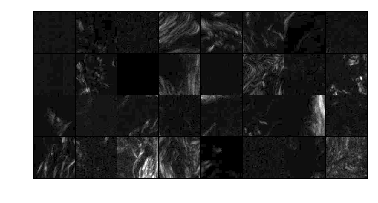

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


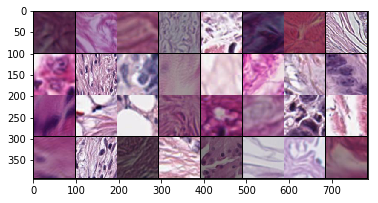

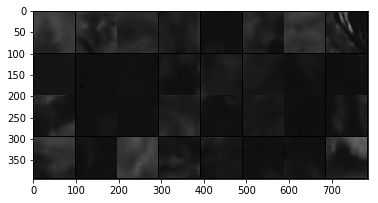

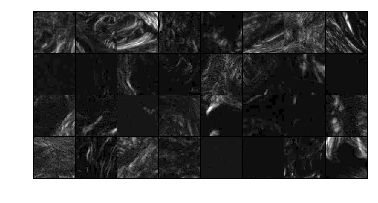

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


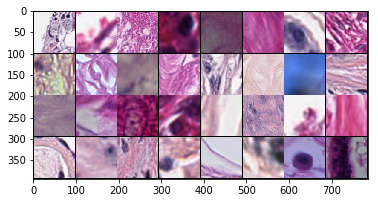

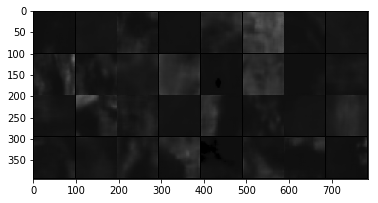

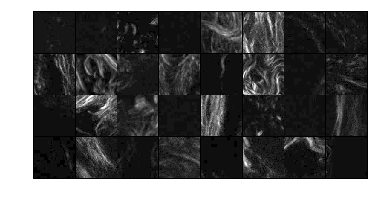

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


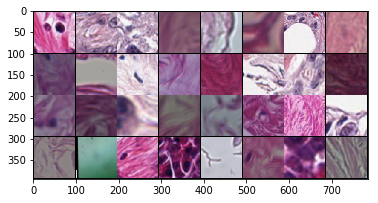

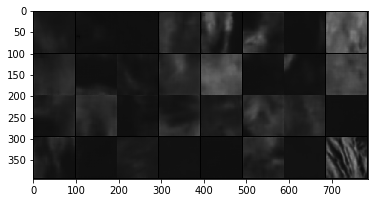

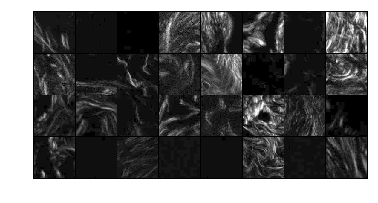

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


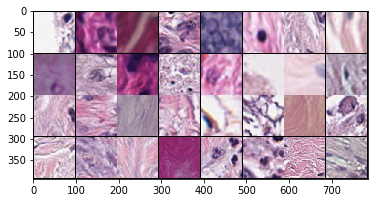

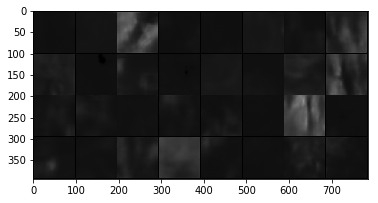

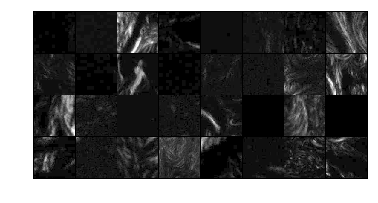

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


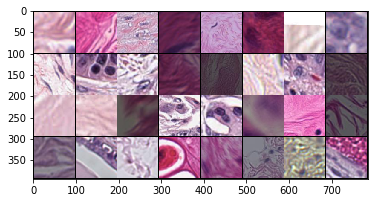

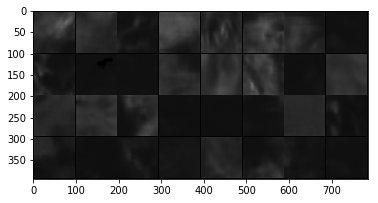

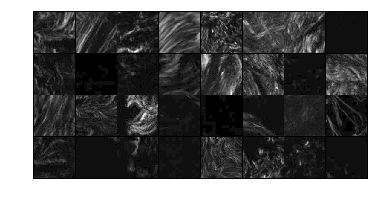

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


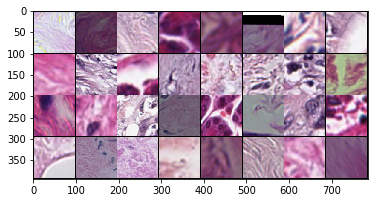

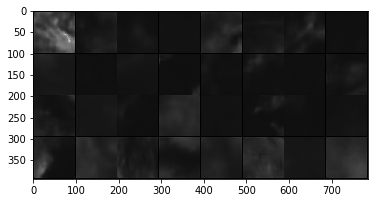

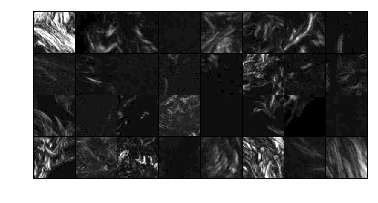

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


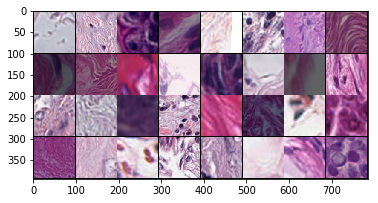

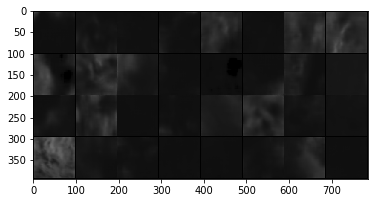

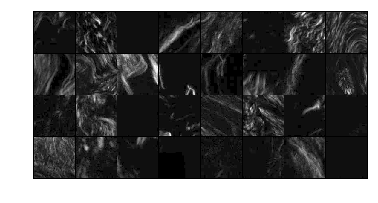

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


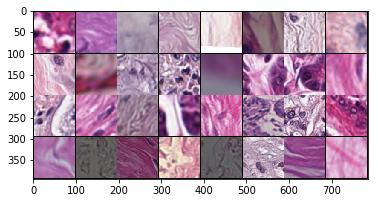

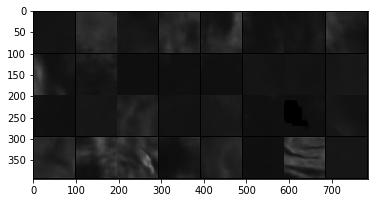

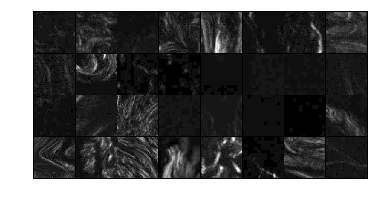

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


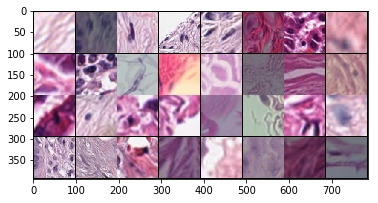

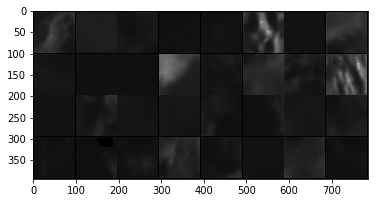

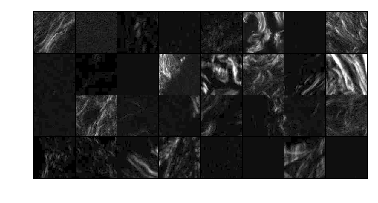

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


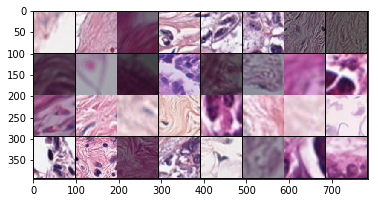

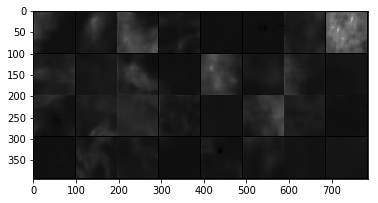

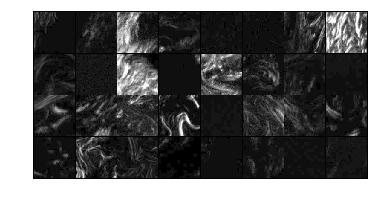

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


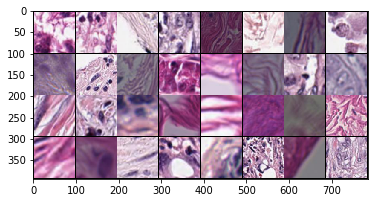

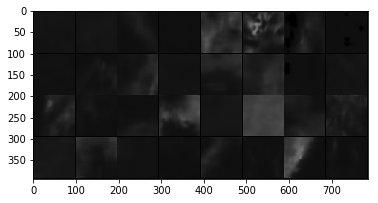

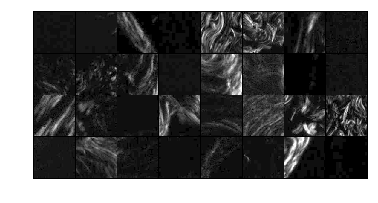

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


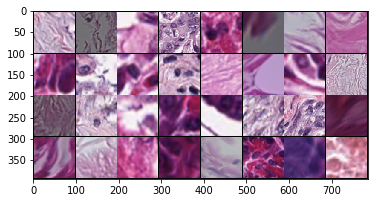

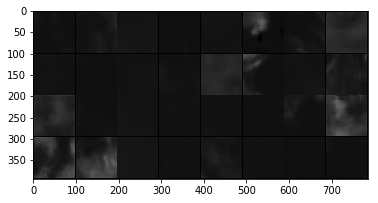

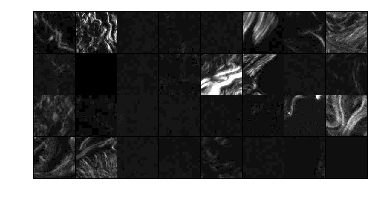

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


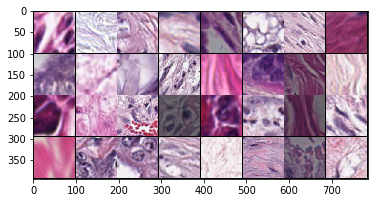

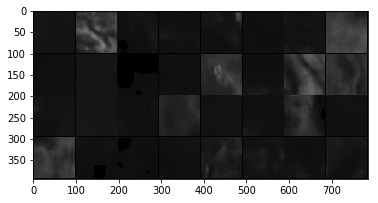

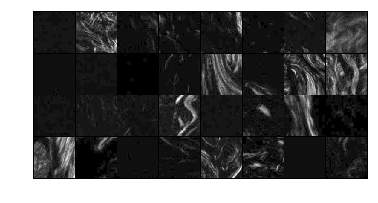

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


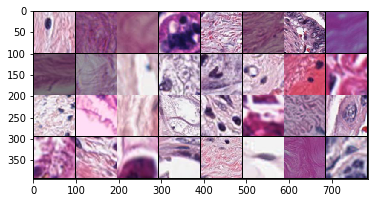

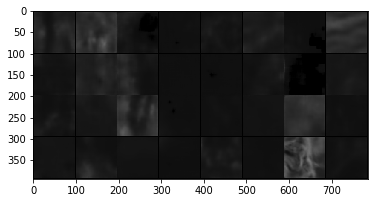

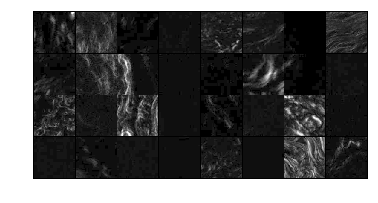

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


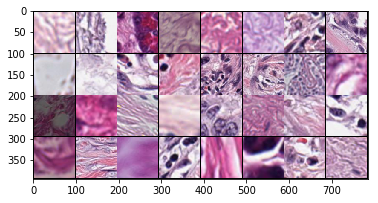

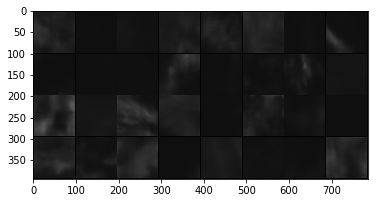

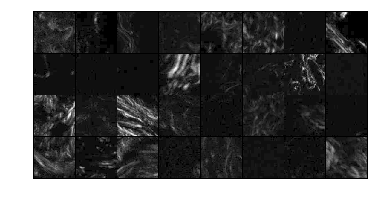

torch.Size([1200, 1, 96, 96]) torch.Size([1200, 96, 96])
torch.Size([32, 1, 96, 96])


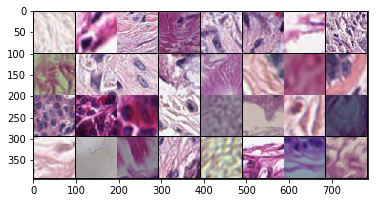

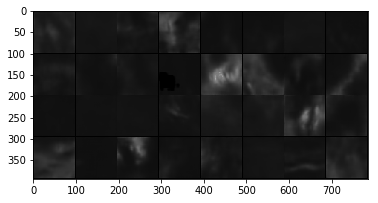

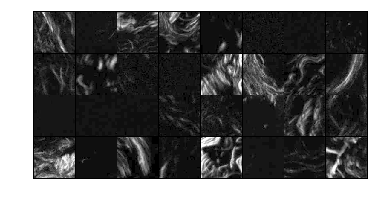

===> Avg. PSNR: nan dB


In [55]:
test()

In [11]:
#--------
# GAN
#--------

import model_ResUGAN as GAN
import torch.nn.functional as F
from torch.autograd import Variable
import numpy as np

In [8]:
# load generator
import os
cwd = os.getcwd();
path = os.path.join(cwd, 'Best model', 'encoderresinfo_0414.pth')
model = md.Net()
gpu_ids = [1, 2, 3, 4, 5, 6]
torch.cuda.set_device(gpu_ids[0])
model = torch.nn.DataParallel(model, device_ids=gpu_ids)
model.load_state_dict(torch.load(path))
model.eval()

DataParallel(
  (module): Net(
    (block0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.1)
    )
    (block1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.1)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.1)
    )
    (info1): Sequential(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.1)
    )
    (block2): Sequential(
      (0): Co

In [13]:
# configure generator
gpu_ids = [1, 2, 3, 4, 5, 6]
torch.cuda.set_device(gpu_ids[0])
model = md.Net()
generator = model
#generator = model.cuda()
# configure discriminator
imgshape = (96, 96)
discriminator = GAN.Discriminator(input_shape=(1, *imgshape))
discriminator = torch.nn.DataParallel(discriminator, device_ids=gpu_ids)
#discriminator = discriminator.cuda()

In [6]:
# configure loss functions
imgshape = (96, 96)
criterionL = nn.L1Loss()
#criterionL = criterionL.cuda()
criterionMSE = nn.MSELoss()
#criterionMSE = criterionMSE.cuda()

In [7]:
# configure training loop
def trainMS(epoch, p, windowsize):
    epoch_loss_G = 0
    epoch_loss_D = 0
    for iteration, batch in enumerate(dataloader):
        input, target = batch['input'].to(device), batch['output'].to(device)
        
        imgs_input = Variable(input.type(Tensor))
        imgs_target = Variable(target.type(Tensor))
        
        valid = Variable(Tensor(np.ones((imgs_input.size(0), 1, 6, 6))), requires_grad=False)
        fake = Variable(Tensor(np.zeros((imgs_input.size(0), 1, 6, 6))), requires_grad=False)
        
        #--------
        # train generator
        #--------
        optimizer_G.zero_grad()
        
        gen_target = generator(imgs_input)
        # adversarial loss
        predictions = discriminator(gen_target)
#         print(predictions.size())
#         print(valid.size())
        lossGAN = criterionMSE(predictions, valid)
        
        # content loss
        targetf = target.float()
        targetf = targetf[:, None]
        lossL1 = criterionL(gen_target, targetf)
        lossSSIM = 1-ssim(gen_target, targetf, window_size=windowsize)
        lossContent = p*lossL1 + (1-p)*lossSSIM
        
        # total loss
        loss_G = lossContent + lossGAN
        
        loss_G.backward()
        optimizer_G.step()
        
        
        if iteration%5 == 0:
        #--------
        # train discriminator
        #--------
            optimizer_D.zero_grad()
        
        # loss of real and fake images
            loss_real = criterionMSE(discriminator(targetf), valid)
            loss_fake = criterionMSE(discriminator(gen_target.detach()), fake)
        
        # Total loss
            loss_D = (loss_real + loss_fake) / 2
        
        
            loss_D.backward()
            optimizer_D.step()
        
        epoch_loss_G = epoch_loss_G + loss_G
        epoch_loss_D = epoch_loss_D + loss_D
        
        if iteration%50 == 0:
            print("Dloss: " + str(loss_D.item()) + " Gloss: " + str(loss_G.item()) + 
                "    L1: " + str(lossL1.item()) + "    SSIM: " + str(lossSSIM.item()))
            print("===> Epoch[{}]({}/{}): Loss: {:.4f}".format(epoch, iteration, len(dataloader), loss_G.item()))

    print("===> Epoch {} Complete: Avg. G Loss: {:.4f}".format(epoch, epoch_loss_G / len(dataloader)))
    print("===> Epoch {} Complete: Avg. D Loss: {:.4f}".format(epoch, epoch_loss_D / len(dataloader)))